# Sales Forecasting

In [532]:
import os

import pandas as pd
import datetime
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
from matplotlib.ticker import StrMethodFormatter
import seaborn as sns
import pmdarima as pm

import plotly
import plotly.figure_factory as ff
import kaleido
import plotly.graph_objects as go
import plotly.express as px

from prophet.plot import plot_plotly, plot_components_plotly

import warnings
warnings.filterwarnings("ignore")
def fxn():
    warnings.warn("deprecated", DeprecationWarning)
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    fxn()


import itertools

import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.api import ExponentialSmoothing, SimpleExpSmoothing, Holt
from statsmodels.tsa.ar_model import AutoReg, ar_select_order
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX

from prophet import Prophet

from pycaret.regression import *
from pycaret.time_series import TSForecastingExperiment

from math import sqrt

import matplotlib

from random import random

from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error, median_absolute_error, mean_squared_log_error

In [188]:
plt.rcParams["figure.dpi"] = 300

plt.style.use('ggplot')
pd.set_option('display.max_columns', None)

pd.set_option('display.float_format', lambda x: '%.3f' % x)

os.environ["CMDSTAN"] = "./cmdstan-2.31.0"


In [189]:
def evaluate_forecast(y,pred):
    results = pd.DataFrame({'r2_score':r2_score(y, pred),
                           }, index=[0])
    results['mean_absolute_error'] = mean_absolute_error(y, pred)
    results['median_absolute_error'] = median_absolute_error(y, pred)
    results['mse'] = mean_squared_error(y, pred)
    results['msle'] = mean_squared_log_error(y, pred)
    results['rmse'] = np.sqrt(results['mse'])
    return results

In [190]:
base_inicial = pd.read_csv('SalesDemand.csv', sep=";",low_memory=False)
base_inicial['date'] = pd.to_datetime(base_inicial['date'])

Tratando datos vacíos

In [191]:
base_inicial.isna().sum()

date     45000
store    45000
item     45000
sales    45000
dtype: int64

In [192]:
base_inicial.dropna(inplace=True)

In [193]:
base_inicial.isna().sum()

date     0
store    0
item     0
sales    0
dtype: int64

Convertir valores a entero

In [194]:
base_inicial['sales'].sample(15)

124763    66.000
54883     27.000
121266    28.000
442361    67.000
657280   111.000
486558    12.000
833888    36.000
646827    42.000
102609    25.000
470693    66.000
756686    18.000
445194    39.000
513017    59.000
245924    48.000
333629    69.000
Name: sales, dtype: float64

In [195]:
base_inicial['store'] = base_inicial['store'].astype(int)
base_inicial['item'] = base_inicial['item'].astype(int)
base_inicial['sales'] = base_inicial['sales'].astype(int)

Contando tiendas y valores

In [196]:
base_inicial['store'].value_counts()

1     91300
2     91300
3     91300
4     91300
5     91300
6     91300
7     91300
8     91300
9     91300
10    91300
Name: store, dtype: int64

Contando número de items

In [197]:
base_inicial['item'].unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50])

In [198]:
base_inicial['item'].nunique()

50

In [199]:
base_inicial

,date,store,item,sales
0,2013-01-01,1,1,13
1,2013-02-01,1,1,11
2,2013-03-01,1,1,14
3,2013-04-01,1,1,13
4,2013-05-01,1,1,10
...,...,...,...,...
912995,2017-12-27,10,50,63
912996,2017-12-28,10,50,59
912997,2017-12-29,10,50,74
912998,2017-12-30,10,50,62


In [200]:
base_inicial.index=base_inicial['date']

Creando variables a parti de la fecha

In [201]:
def crear_vars(df):
    
    df = df.copy()
    df['quarter'] = df.index.quarter
    df['month'] = df.index.month
    df['year'] = df.index.year
    df['dayofyear'] = df.index.dayofyear
    df['dayofmonth'] = df.index.day
    df['weekofyear'] = df.index.isocalendar().week
    df['dayofweek'] = df.index.dayofweek
    df['is_weekday'] = [i.isoweekday() for i in df.index]
    df['weekofyear'] = df['weekofyear'].astype('int64')
    
    return df

base_inicial = crear_vars(base_inicial)

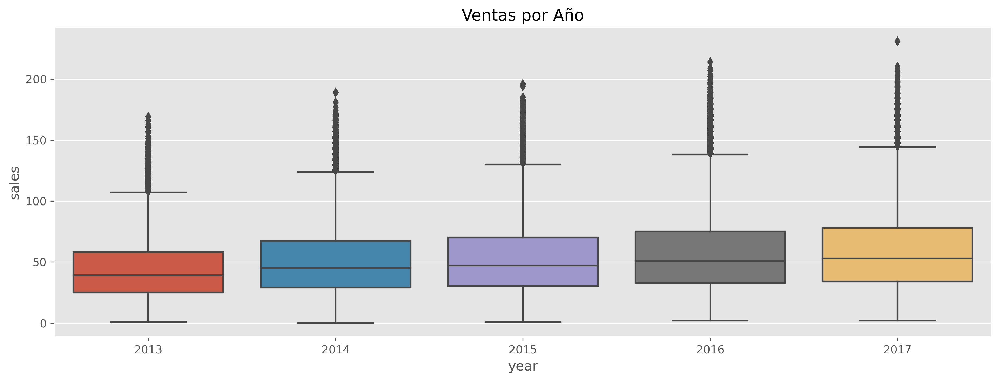

In [202]:
fig, ax = plt.subplots(figsize=(15, 5))
sns.boxplot(data=base_inicial, x='year', y='sales')
ax.set_title('Ventas por Año')
plt.show()

En términos de ventas anuales totales, se ve una tendencia al alza del valor mediano de ventas

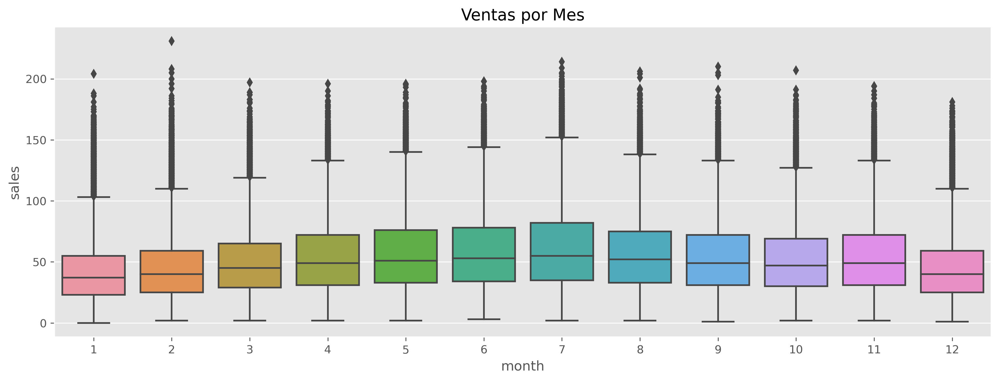

In [203]:
fig, ax = plt.subplots(figsize=(15, 5))
sns.boxplot(data=base_inicial, x='month', y='sales')
ax.set_title('Ventas por Mes')
plt.show()

Según los gráficos de cajas, parece haber un aumento de ventas entre los meses de junio y julio, a comparación de los demás meses.

Análisis visual de ventas por tienda e items

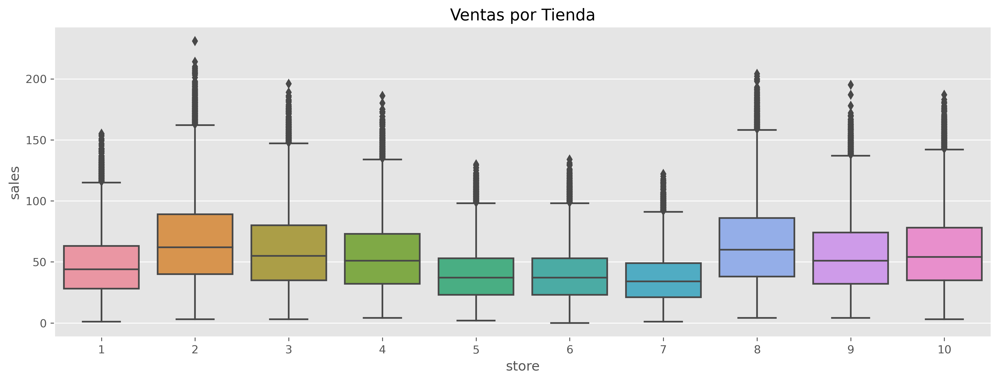

In [204]:
fig, ax = plt.subplots(figsize=(15, 5))
sns.boxplot(data=base_inicial, x='store', y='sales')
ax.set_title('Ventas por Tienda')
plt.show()

Text(0.5, 1.0, 'Ventas por tienda')

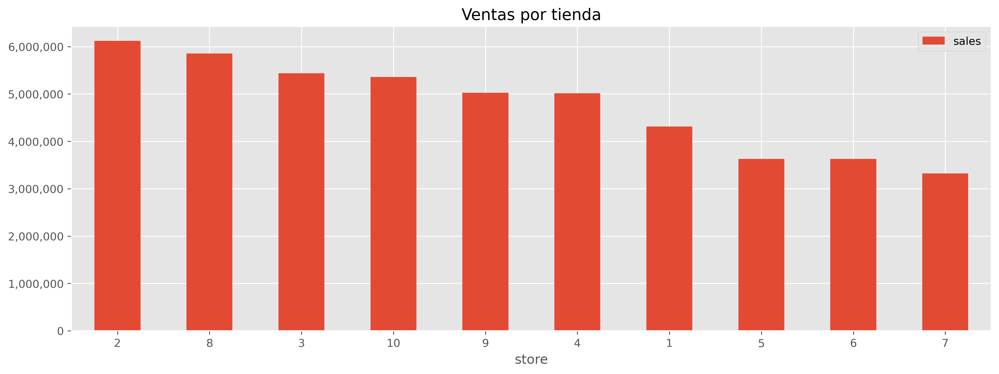

In [205]:
base_inicial.groupby('store').sum('sales')[['sales']].sort_values('sales', ascending=False).plot(kind='bar', figsize=(15,5))
plt.gca().yaxis.set_major_formatter(StrMethodFormatter('{x:,.0f}')) # No decimal places
plt.xticks(rotation=0)
plt.title('Ventas por tienda')

Se puede apreciar que las tiendas 2 y 8 son las que concentran el mayor número de ventas

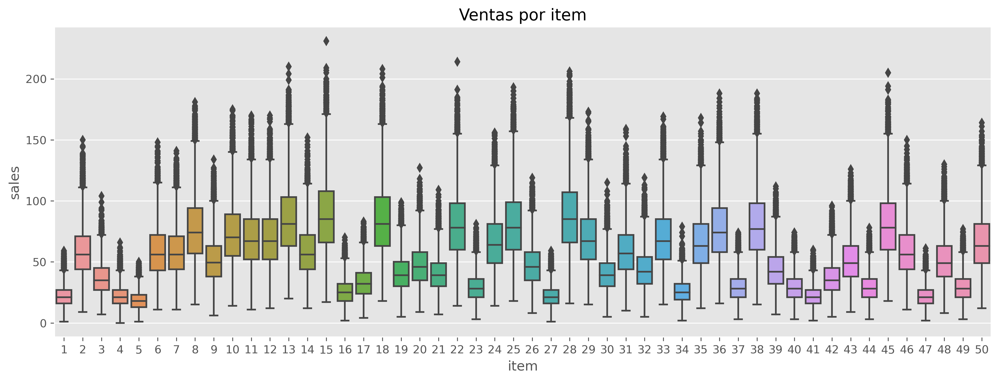

In [206]:
fig, ax = plt.subplots(figsize=(15, 5))
sns.boxplot(data=base_inicial, x='item', y='sales')
ax.set_title('Ventas por item')
plt.show()

Text(0.5, 1.0, 'Ventas por item')

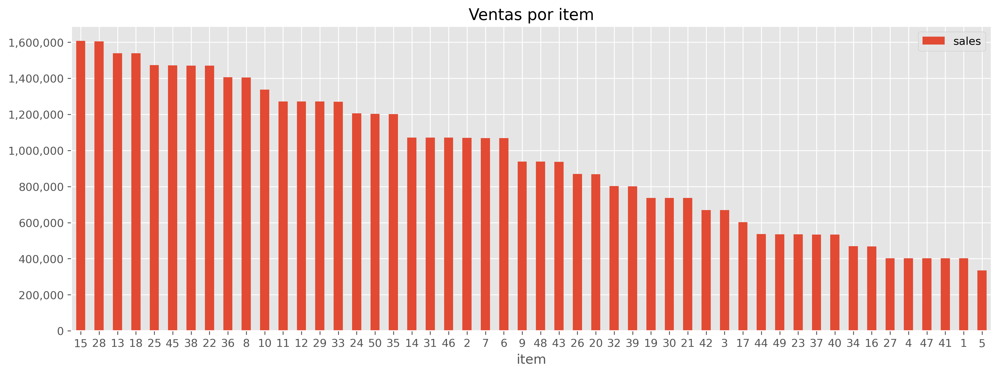

In [207]:
base_inicial.groupby('item').sum('sales')[['sales']].sort_values('sales', ascending=False).plot(kind='bar', figsize=(15,5))
plt.gca().yaxis.set_major_formatter(StrMethodFormatter('{x:,.0f}')) # No decimal places
plt.xticks(rotation=0)
plt.title('Ventas por item')

Se puede apreciar que los items 15 y 28 son los más vendidos

Text(0.5, 1.0, 'Ventas por item - Tienda 2')

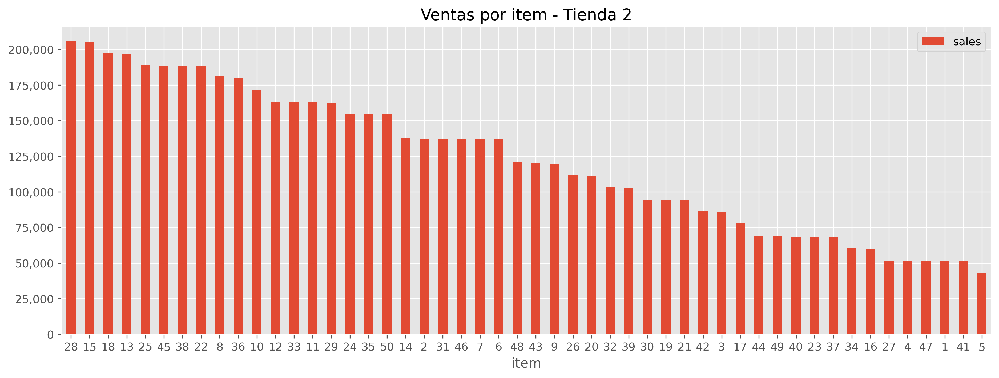

In [208]:
base_inicial[base_inicial['store']==2].groupby('item').sum('sales')[['sales']].sort_values('sales', ascending=False).plot(kind='bar', figsize=(15,5))
plt.gca().yaxis.set_major_formatter(StrMethodFormatter('{x:,.0f}')) # No decimal places
plt.xticks(rotation=0)
plt.title('Ventas por item - Tienda 2')

Se puede apreciar que los items 15 y 28 son los más vendidos en la tienda 8 también

Por esta razón, en el presente trabajo se centrará en la predicción de las ventas del item 28 de la tienda 2

In [209]:
base_inicial

,date,store,item,sales,quarter,month,year,dayofyear,dayofmonth,weekofyear,dayofweek,is_weekday
date,,,,,,,,,,,,
2013-01-01,2013-01-01,1,1,13,1,1,2013,1,1,1,1,2
2013-02-01,2013-02-01,1,1,11,1,2,2013,32,1,5,4,5
2013-03-01,2013-03-01,1,1,14,1,3,2013,60,1,9,4,5
2013-04-01,2013-04-01,1,1,13,2,4,2013,91,1,14,0,1
2013-05-01,2013-05-01,1,1,10,2,5,2013,121,1,18,2,3
...,...,...,...,...,...,...,...,...,...,...,...,...
2017-12-27,2017-12-27,10,50,63,4,12,2017,361,27,52,2,3
2017-12-28,2017-12-28,10,50,59,4,12,2017,362,28,52,3,4
2017-12-29,2017-12-29,10,50,74,4,12,2017,363,29,52,4,5


Filtrando por tienda e item

In [210]:
tienda2 = base_inicial[base_inicial['store']==2]
tienda2.drop(columns=['store'],inplace=True)

Verificamos que no hayan brechas entre los periodos de tiempo

In [211]:
(tienda2[tienda2['item']==28]['date'].sort_values().diff() > pd.to_timedelta('1 day')).unique()

array([False])

In [212]:
tienda2_i28 = tienda2[tienda2['item']==28]
tienda2_i28.sort_index(inplace=True)

## Probando con Data Diaria

In [213]:
fig = px.line(tienda2_i28, x="date", y=['sales'],
            title="Ventas Tienda 2 - item 28 | Diario",
            template = 'plotly_dark'
            ).update_layout(
            xaxis_title="Fecha", yaxis_title="Ventas"
)
            
fig.update_xaxes(
    tickformat="%y/%m")
fig.show()

En un primer análisis visual, la data parece ser muy volátil, con una pequeña tendencia creciente y aumentos específicos en el mes de julio de cada año

<AxesSubplot:ylabel='Density'>

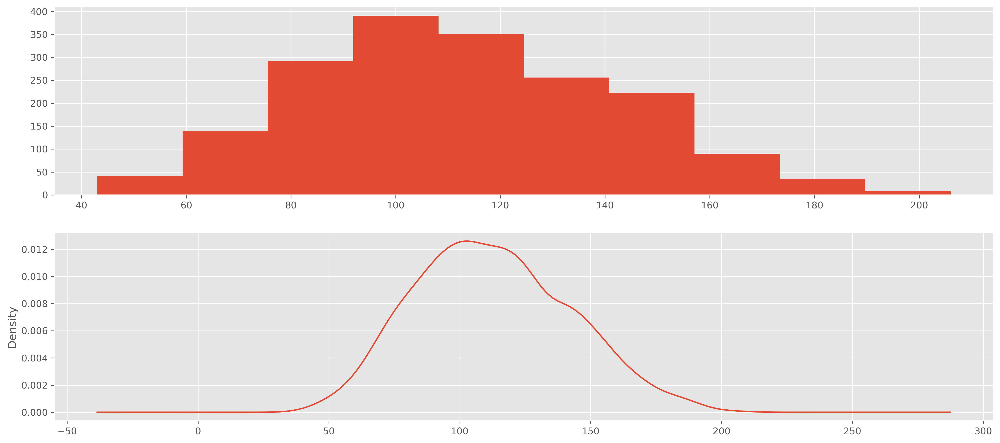

In [214]:
plt.figure(1)
plt.subplot(211)
tienda2_i28['sales'].hist()
plt.subplot(212)
tienda2_i28['sales'].plot(kind='kde')

La distribución no es normal, los datos tienden a concentrarse en el valor de 100

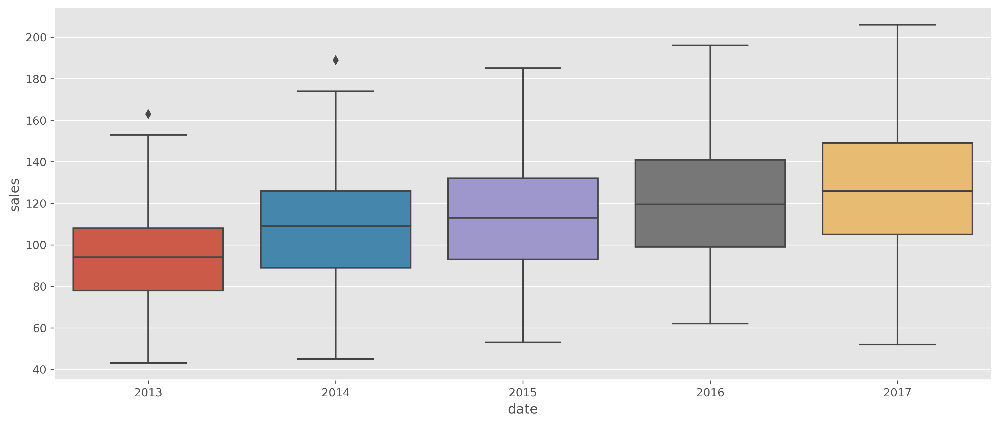

In [215]:
fig, ax = plt.subplots(figsize=(15,6))
sns.boxplot(x=tienda2_i28['sales'].index.year, y=tienda2_i28['sales'], ax=ax)
plt.show()

Ligera tendencia al alza en valores medianos a través delos años

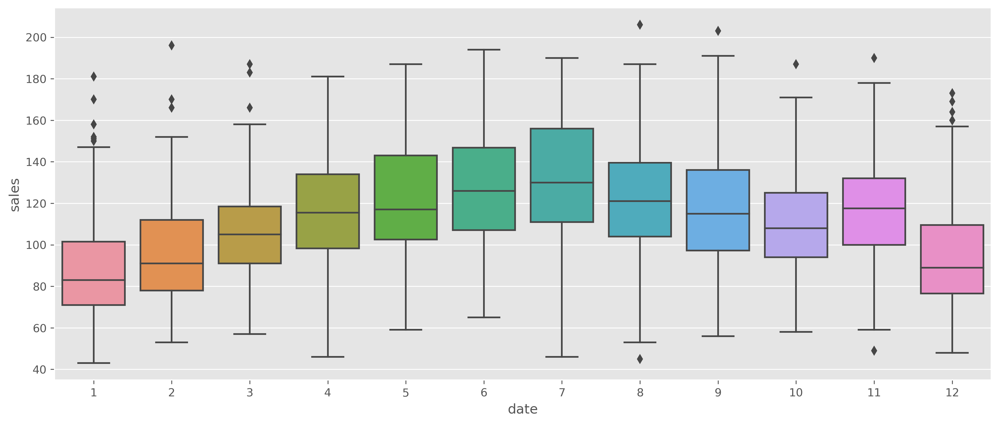

In [216]:
fig, ax = plt.subplots(figsize=(15,6))
sns.boxplot(x=tienda2_i28['sales'].index.month, y=tienda2_i28['sales'], ax=ax)
plt.show()

Parece haber un comportamiento estacional a alrededor de julio

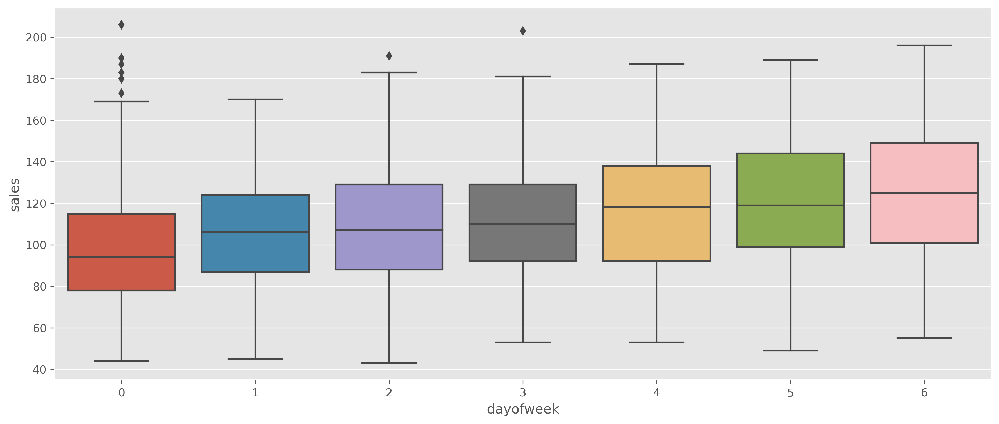

In [217]:
fig, ax = plt.subplots(figsize=(15,6))
sns.boxplot(x=tienda2_i28['dayofweek'], y=tienda2_i28['sales'], ax=ax)
plt.show()

Las ventas son mayores el último día de la semana

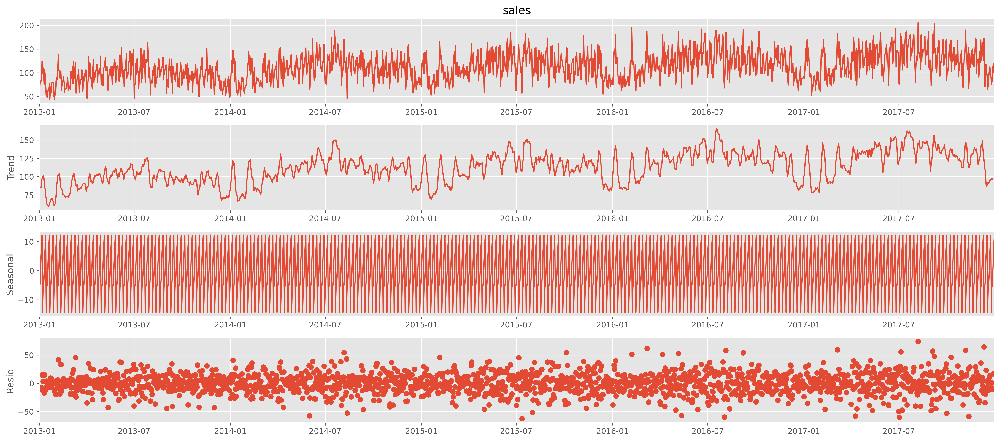

In [218]:
matplotlib.rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(tienda2_i28['sales']) #model='multiplicative')
fig = decomposition.plot()
plt.show()

Se puede apreciar que no hay una constante tendencia de aumento en la serie; sin embargo, el valor llega a aumentar a lo largo de los años. Asimismo, se ven los picos a mediados de cada año.

<AxesSubplot:xlabel='date'>

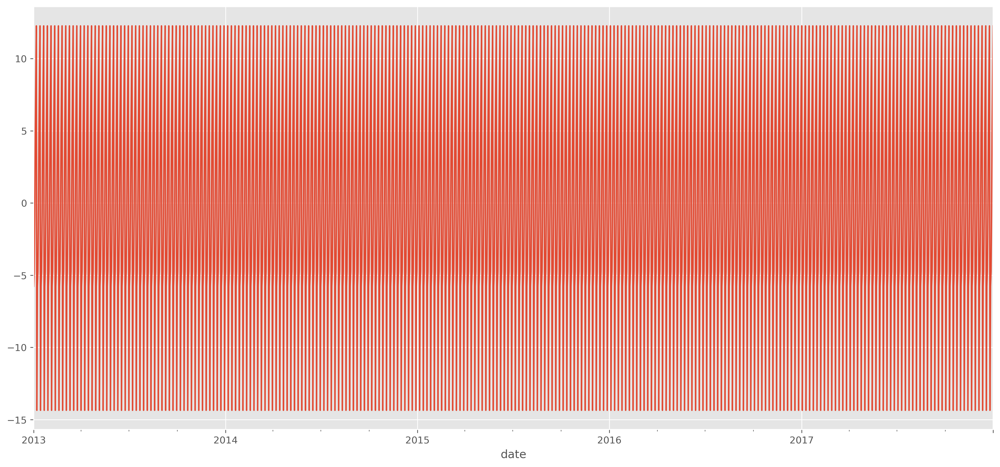

In [219]:
decomposition.seasonal.plot()

La estacionalidad es muy volatil, pero similar

<AxesSubplot:xlabel='date'>

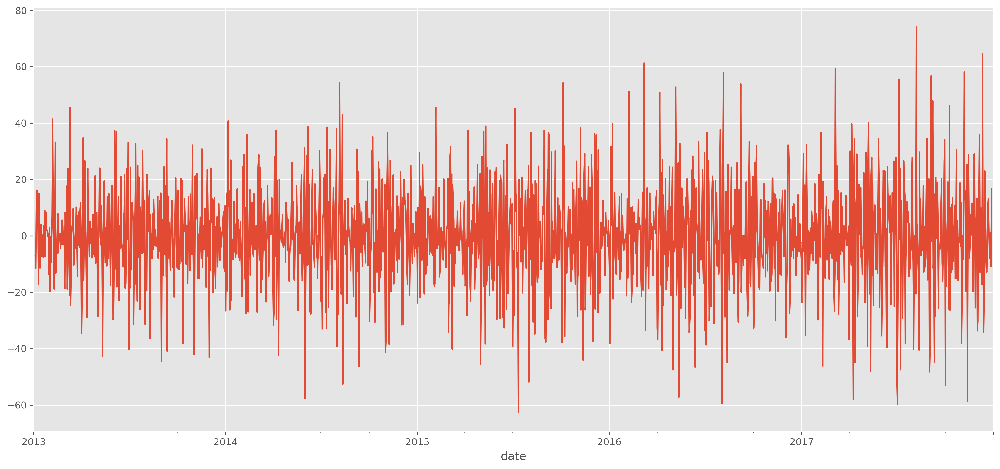

In [220]:
decomposition.resid.plot()

Pareciera no haber un patron en los residuos

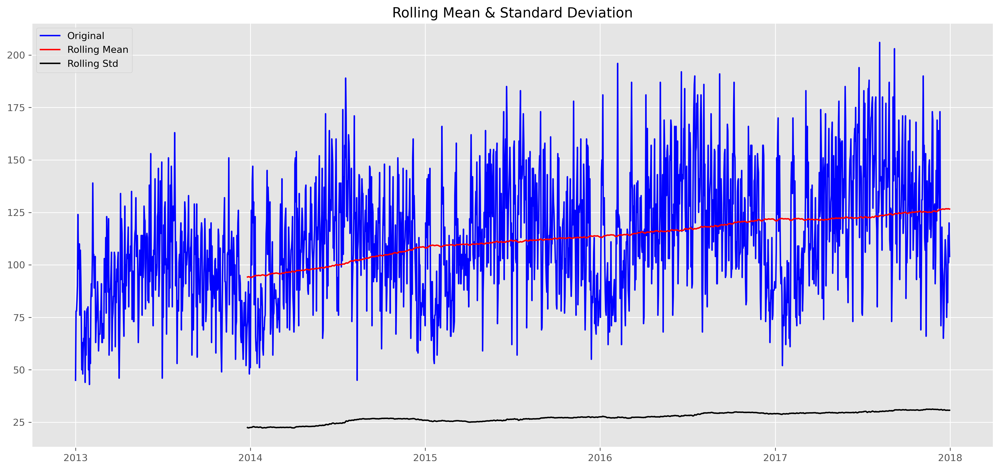

In [221]:
rolmean = tienda2_i28['sales'].rolling(360).mean()
rolstd = tienda2_i28['sales'].rolling(360).std()

#Graficando estadísticas continuas
orig = plt.plot(tienda2_i28['sales'], color='blue',label='Original')
mean = plt.plot(rolmean, color='red', label='Rolling Mean')
std = plt.plot(rolstd, color='black', label = 'Rolling Std')
plt.legend(loc='best')
plt.title('Rolling Mean & Standard Deviation')
plt.show(block=False)

La desviacion estandar parece ser ligeramente constante en el tiempo.

la media movil parece tener un aumento ligero en el tiempo.

In [222]:
#Perform Dickey-Fuller test:
print ('Results of Dickey-Fuller Test:')
dftest = adfuller(tienda2_i28['sales'], autolag='AIC', regression='ctt')
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
for key,value in dftest[4].items():
    dfoutput['Critical Value (%s)'%key] = value
print (dfoutput)

Results of Dickey-Fuller Test:
Test Statistic                  -5.388
p-value                          0.000
#Lags Used                      25.000
Number of Observations Used   1800.000
Critical Value (1%)             -4.378
Critical Value (5%)             -3.836
Critical Value (10%)            -3.555
dtype: float64


In [223]:
#Perform Dickey-Fuller test:
print ('Results of Dickey-Fuller Test:')
dftest = adfuller(tienda2_i28['sales'], autolag='AIC', regression='ct')
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
for key,value in dftest[4].items():
    dfoutput['Critical Value (%s)'%key] = value
print (dfoutput)

Results of Dickey-Fuller Test:
Test Statistic                  -5.343
p-value                          0.000
#Lags Used                      25.000
Number of Observations Used   1800.000
Critical Value (1%)             -3.964
Critical Value (5%)             -3.413
Critical Value (10%)            -3.128
dtype: float64


In [224]:
#Perform Dickey-Fuller test:
print ('Results of Dickey-Fuller Test:')
dftest = adfuller(tienda2_i28['sales'], autolag='AIC',regression='c')
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
for key,value in dftest[4].items():
    dfoutput['Critical Value (%s)'%key] = value
print (dfoutput)

Results of Dickey-Fuller Test:
Test Statistic                  -4.331
p-value                          0.000
#Lags Used                      25.000
Number of Observations Used   1800.000
Critical Value (1%)             -3.434
Critical Value (5%)             -2.863
Critical Value (10%)            -2.568
dtype: float64


Segun el test Dickey-Fuller aumentado, el pvalor es 0.000, entonces, se rechaza la hipótesis nula y la se confirma que la serie es estacionaria.

### Prophet

Se probará primero con los dos últimos años

In [225]:
tienda2_i28_1 = tienda2_i28[tienda2_i28['year']>=2016].copy()

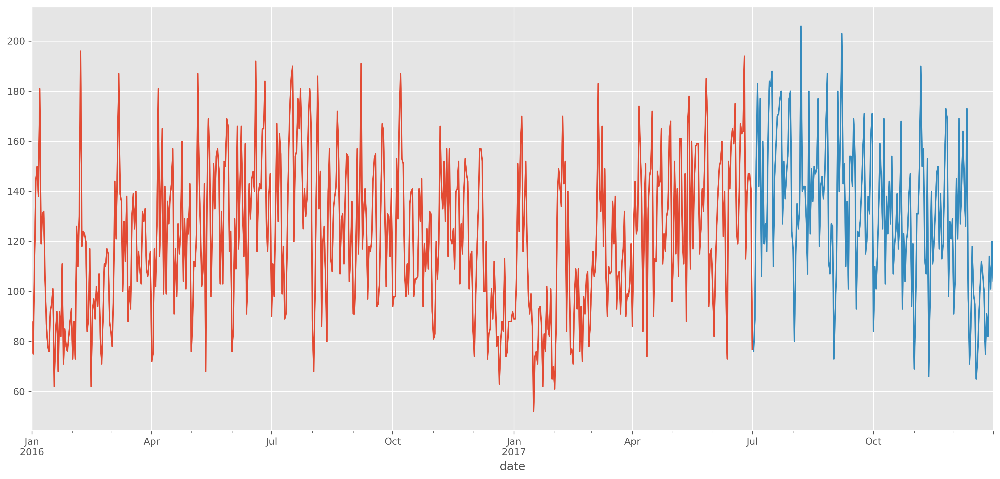

In [226]:
train = tienda2_i28_1[['sales']][:int(0.75*(len(tienda2_i28_1['sales'])))]
valid = tienda2_i28_1[['sales']][int(0.75*(len(tienda2_i28_1['sales']))):]

#plotting the data
train['sales'].plot()
valid['sales'].plot()
plt.show()

In [227]:
train.shape, valid.shape

((548, 1), (183, 1))

In [228]:
train_prophet = pd.DataFrame()
train_prophet['ds'] = train.index
train_prophet['y'] = train['sales'].values

In [229]:
model = Prophet(yearly_seasonality=True, seasonality_mode = 'multiplicative')
model.fit(train_prophet)

20:22:14 - cmdstanpy - INFO - Chain [1] start processing
20:22:14 - cmdstanpy - INFO - Chain [1] done processing


In [230]:
future = model.make_future_dataframe(periods = valid.shape[0], freq = 'D') 
future

,ds
0,2016-01-01
1,2016-01-02
2,2016-01-03
3,2016-01-04
4,2016-01-05
...,...
726,2017-12-27
727,2017-12-28
728,2017-12-29
729,2017-12-30


In [231]:
forecast = model.predict(future)
forecast[['ds', 'yhat']]

,ds,yhat
0,2016-01-01,115.561
1,2016-01-02,118.490
2,2016-01-03,124.544
3,2016-01-04,92.860
4,2016-01-05,103.775
...,...,...
726,2017-12-27,105.517
727,2017-12-28,112.174
728,2017-12-29,117.669
729,2017-12-30,121.379


In [232]:
fig = plot_plotly(model, forecast)

fig.update_layout(
    autosize=False,
    width=1400,
    height=600)

In [233]:
future['ds'].iloc[0]

Timestamp('2016-01-01 00:00:00')

In [234]:
future['ds'].iloc[-1]

Timestamp('2017-12-31 00:00:00')

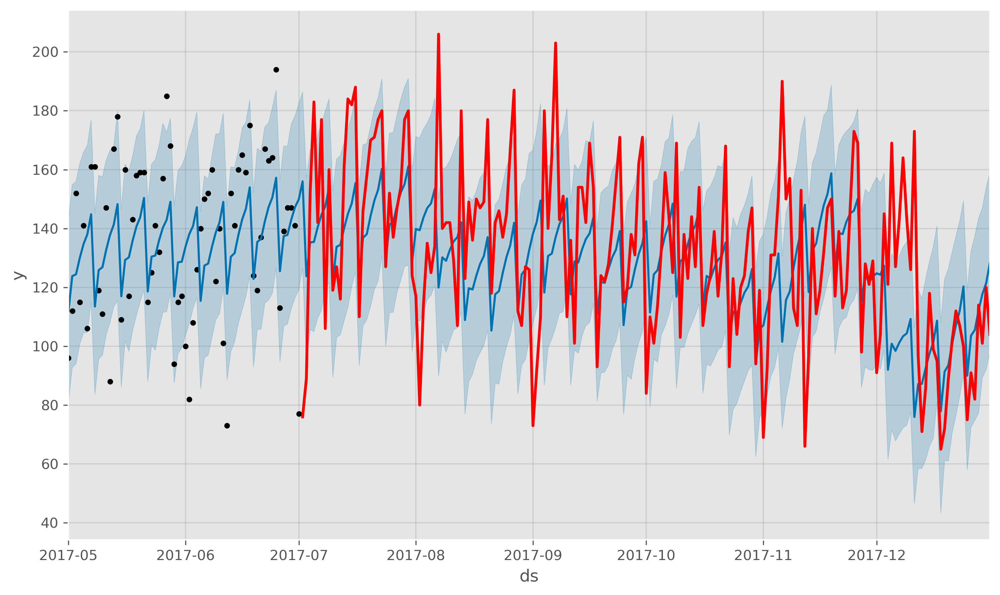

In [235]:
fig = model.plot(forecast)

plt.plot(valid, label='Valid', color = 'red', linewidth = 2)

plt.xlim([datetime.date(2017, 5, 1), datetime.date(2017, 12, 31)])

plt.show()

In [236]:
fig = plot_components_plotly(model, forecast)
fig.update_layout(
    autosize=False,
    width=1400,
    height=600)

In [237]:
evaluate_forecast(tienda2_i28_1['sales'], forecast['yhat'])

,r2_score,mean_absolute_error,median_absolute_error,mse,msle,rmse
0,0.311,18.755,14.421,619.527,0.042,24.890


debido a las métricas con este periodo de tiempo, se utilizarán los últimos 3 años

In [238]:
tienda2_i28_2 = tienda2_i28[tienda2_i28['year']>=2015].copy()

In [239]:
#Perform Dickey-Fuller test:
print ('Results of Dickey-Fuller Test:')
dftest = adfuller(tienda2_i28_2['sales'], autolag='AIC')
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
for key,value in dftest[4].items():
    dfoutput['Critical Value (%s)'%key] = value
print (dfoutput)

Results of Dickey-Fuller Test:
Test Statistic                  -4.339
p-value                          0.000
#Lags Used                      21.000
Number of Observations Used   1074.000
Critical Value (1%)             -3.436
Critical Value (5%)             -2.864
Critical Value (10%)            -2.568
dtype: float64


In [240]:
train = tienda2_i28_2[['sales']][:int(0.75*(len(tienda2_i28_1['sales'])))]
valid = tienda2_i28_2[['sales']][int(0.75*(len(tienda2_i28_1['sales']))):]

train_prophet = pd.DataFrame()
train_prophet['ds'] = train.index
train_prophet['y'] = train['sales'].values

In [241]:
model = Prophet(yearly_seasonality=True, seasonality_mode = 'multiplicative')
model.fit(train_prophet)

20:22:15 - cmdstanpy - INFO - Chain [1] start processing
20:22:15 - cmdstanpy - INFO - Chain [1] done processing


In [242]:
future = model.make_future_dataframe(periods = valid.shape[0], freq = 'D') 
future

,ds
0,2015-01-01
1,2015-01-02
2,2015-01-03
3,2015-01-04
4,2015-01-05
...,...
1091,2017-12-27
1092,2017-12-28
1093,2017-12-29
1094,2017-12-30


In [243]:
forecast = model.predict(future)
forecast[['ds', 'yhat']]

,ds,yhat
0,2015-01-01,99.744
1,2015-01-02,106.424
2,2015-01-03,111.245
3,2015-01-04,113.727
4,2015-01-05,88.267
...,...,...
1091,2017-12-27,116.055
1092,2017-12-28,117.826
1093,2017-12-29,126.733
1094,2017-12-30,133.432


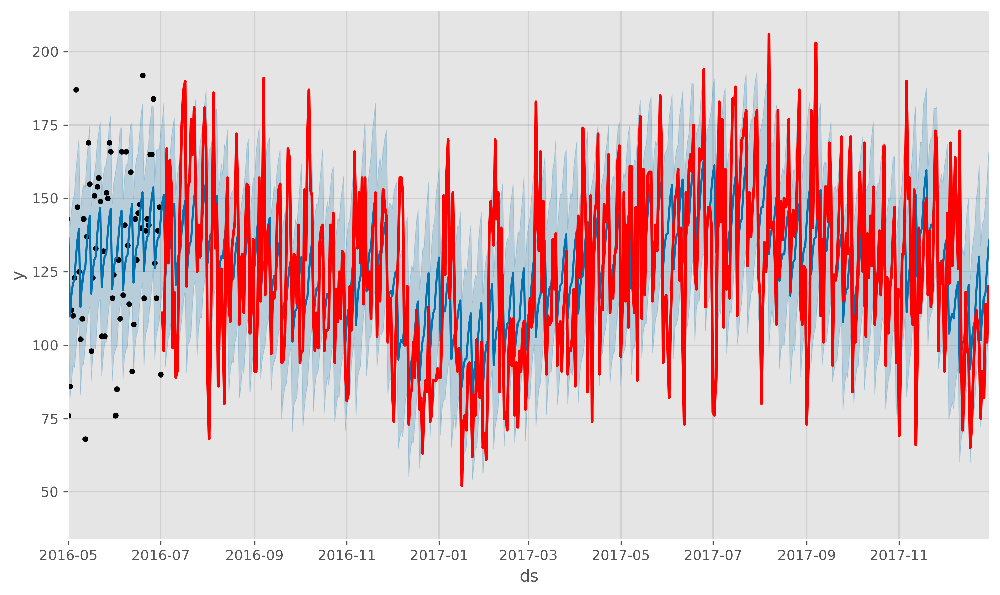

In [244]:
fig = model.plot(forecast)

plt.plot(valid, label='Valid', color = 'red', linewidth = 2)

plt.xlim([datetime.date(2016, 5, 1), datetime.date(2017, 12, 31)])

plt.show()

In [245]:
evaluate_forecast(tienda2_i28_2['sales'], forecast['yhat'])

,r2_score,mean_absolute_error,median_absolute_error,mse,msle,rmse
0,0.315,18.866,15.230,599.541,0.044,24.486


el modelo mejoró significativamente como se aprecia visualmente y en las métricas

Prediciendo el siguiente mes

In [246]:
train = tienda2_i28_2[['sales']]


train_prophet = pd.DataFrame()
train_prophet['ds'] = train.index
train_prophet['y'] = train['sales'].values

In [247]:
model = Prophet(yearly_seasonality=True, seasonality_mode = 'multiplicative')
model.fit(train_prophet)

20:22:16 - cmdstanpy - INFO - Chain [1] start processing
20:22:16 - cmdstanpy - INFO - Chain [1] done processing


In [248]:
future = model.make_future_dataframe(periods = 31, freq = 'D') 
future

,ds
0,2015-01-01
1,2015-01-02
2,2015-01-03
3,2015-01-04
4,2015-01-05
...,...
1122,2018-01-27
1123,2018-01-28
1124,2018-01-29
1125,2018-01-30


In [249]:
forecast = model.predict(future)

In [250]:
future['ds'].iloc[-1-31]

Timestamp('2017-12-31 00:00:00')

In [251]:
future['ds'].iloc[-1]

Timestamp('2018-01-31 00:00:00')

Text(0.5, 1.0, 'Predicción del Mes siguiente del item 28 de la tienda 2 con Prophet')

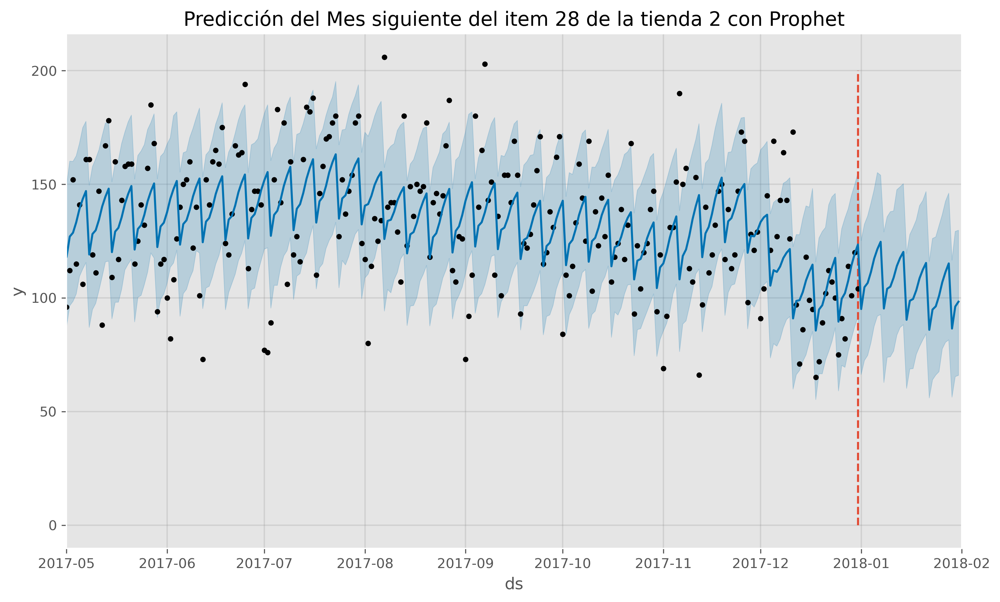

In [252]:
fig = model.plot(forecast)

plt.xlim([datetime.date(2017, 5, 1), datetime.date(2018, 2, 1)])

plt.vlines(datetime.date(2017, 12, 31 ), ymin=0, ymax=200, linestyles='dashed')

plt.title('Predicción del Mes siguiente del item 28 de la tienda 2 con Prophet')

Ventas totales del siguiente mes

In [268]:
Ventas_D_Prophet = forecast[forecast['ds'].dt.year==2018]['yhat'].sum().round(2)
Ventas_D_Prophet

3266.96

### Simple exponencial smoothing (SES)

<AxesSubplot:title={'center':'Single Exponential Smoothing'}, xlabel='date'>

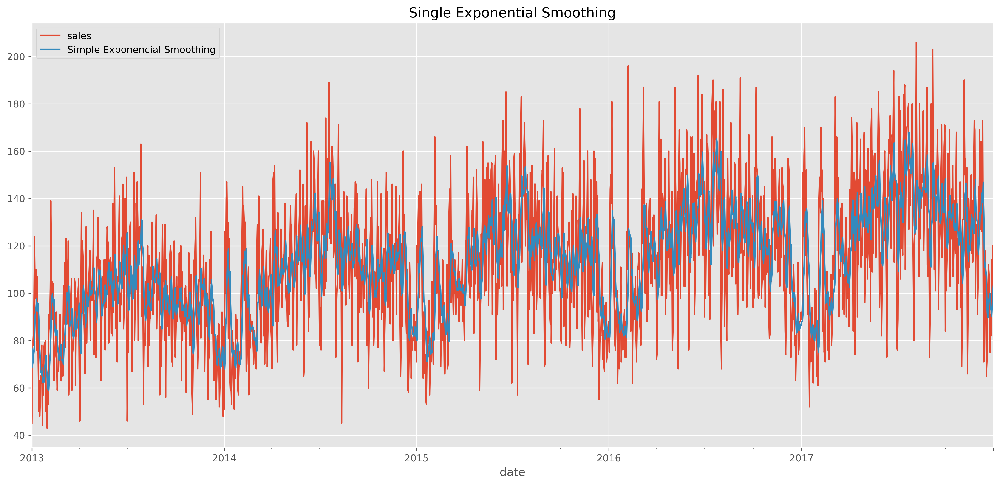

In [291]:
HWES1 = SimpleExpSmoothing(tienda2_i28['sales'], initialization_method="estimated").fit()

HWES1_fitted = HWES1.fittedvalues
HWES1_fitted.name = 'Simple Exponencial Smoothing'
pd.concat([tienda2_i28['sales'], HWES1_fitted], axis=1).plot(title='Single Exponential Smoothing')

In [292]:
results = pd.DataFrame(
    index=["SSE", "AIC", "BIC"])
results["Simple Exponencial"] = [HWES1.sse] + [HWES1.aic] + [HWES1.bic] 

In [293]:
print(HWES1.summary())

                       SimpleExpSmoothing Model Results                       
Dep. Variable:                  sales   No. Observations:                 1826
Model:             SimpleExpSmoothing   SSE                        1126779.357
Optimized:                       True   AIC                          11736.033
Trend:                           None   BIC                          11747.053
Seasonal:                        None   AICC                         11736.055
Seasonal Periods:                None   Date:                 Sun, 02 Jul 2023
Box-Cox:                        False   Time:                         20:27:39
Box-Cox Coeff.:                  None                                         
                       coeff                 code              optimized      
------------------------------------------------------------------------------
smoothing_level            0.2459782                alpha                 True
initial_level              76.597867                

### Double exponencial smoothing (DES)

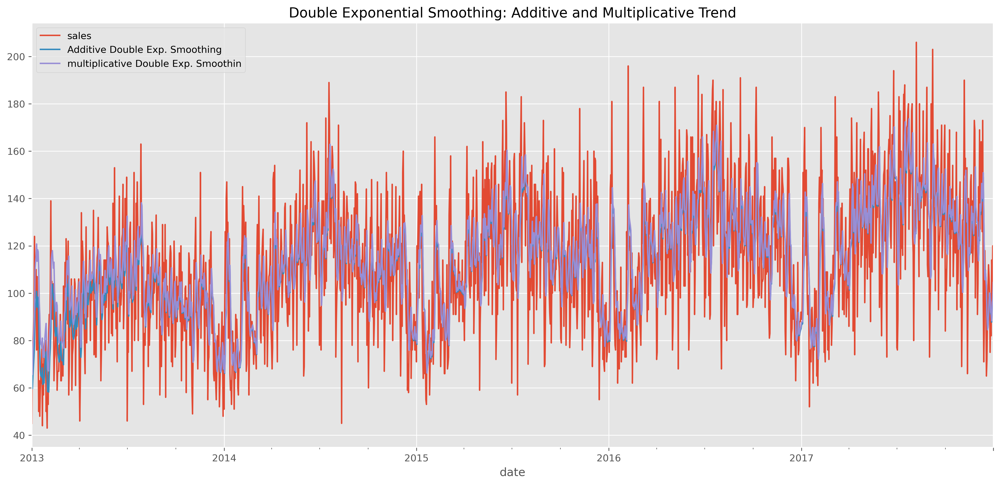

In [294]:
HWES2_ADD = ExponentialSmoothing(tienda2_i28['sales'],trend='add').fit()#.fittedvalues
HWES2_MUL = ExponentialSmoothing(tienda2_i28['sales'],trend='mul').fit()#.fittedvalues
HWES2_ADD_fitted = HWES2_ADD.fittedvalues
HWES2_MUL_fitted = HWES2_MUL.fittedvalues
HWES2_ADD_fitted.name = 'Additive Double Exp. Smoothing'
HWES2_MUL_fitted.name = 'multiplicative Double Exp. Smoothin'
pd.concat([tienda2_i28['sales'], HWES2_ADD_fitted, HWES2_MUL_fitted], axis=1).plot(title='Double Exponential Smoothing: Additive and Multiplicative Trend');

In [295]:
results["Double Exp. - Additive"] = [HWES2_ADD.sse] + [HWES2_ADD.aic] + [HWES2_ADD.bic] 
results["Double Exp. - Multiplicative"] = [HWES2_MUL.sse] + [HWES2_MUL.aic] + [HWES2_MUL.bic] 

In [296]:
HWES2_ADD.summary()

Dep. Variable:,sales,No. Observations:,1826
Model:,ExponentialSmoothing,SSE,1141493.068
Optimized:,True,AIC,11763.723
Trend:,Additive,BIC,11785.763
Seasonal:,None,AICC,11763.770
Seasonal Periods:,None,Date:,"Sun, 02 Jul 2023"
Box-Cox:,False,Time:,20:27:40
Box-Cox Coeff.:,None,,
,coeff,code,optimized
smoothing_level,0.2885840,alpha,True
smoothing_trend,0.0127764,beta,True


El beta de tendencia influye poco en la serie

### Triple exponencial smoothing (TES)

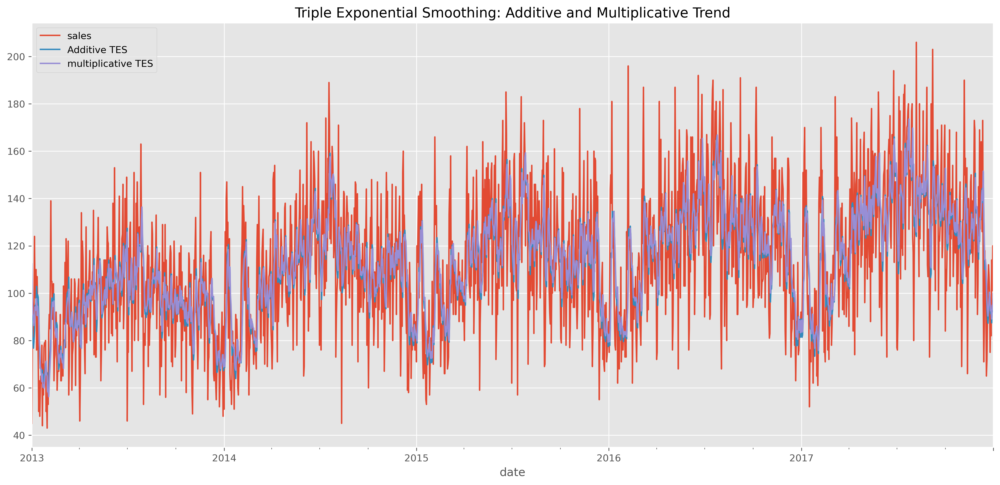

In [297]:
HWES3_ADD = ExponentialSmoothing(tienda2_i28['sales'],trend='add',seasonal='add',seasonal_periods=12).fit()
HWES3_MUL = ExponentialSmoothing(tienda2_i28['sales'],trend='mul',seasonal='mul',seasonal_periods=12).fit()

HWES3_ADD_fitted = HWES3_ADD.fittedvalues
HWES3_MUL_fitted = HWES3_MUL.fittedvalues
HWES3_ADD_fitted.name = 'Additive TES'
HWES3_MUL_fitted.name = 'multiplicative TES'
pd.concat([tienda2_i28['sales'], HWES3_ADD_fitted, HWES3_MUL_fitted], axis=1).plot(title='Triple Exponential Smoothing: Additive and Multiplicative Trend');

In [298]:
results["Triple Exp. - Additive"] = [HWES3_ADD.sse] + [HWES3_ADD.aic] + [HWES3_ADD.bic] 
results["Triple Exp. - Multiplicative"] = [HWES3_MUL.sse] + [HWES3_MUL.aic] + [HWES3_MUL.bic] 

In [299]:
HWES3_MUL.summary()

Dep. Variable:,sales,No. Observations:,1826
Model:,ExponentialSmoothing,SSE,1180383.490
Optimized:,True,AIC,11848.899
Trend:,Multiplicative,BIC,11937.057
Seasonal:,Multiplicative,AICC,11849.277
Seasonal Periods:,12,Date:,"Sun, 02 Jul 2023"
Box-Cox:,False,Time:,20:27:42
Box-Cox Coeff.:,None,,
,coeff,code,optimized
smoothing_level,0.2171579,alpha,True
smoothing_trend,0.0167110,beta,True


El beta de tendencia y gamma estacional general resultan bajos. Sin embargo, la parte estacional de cada periodo si influye.

In [300]:
results

,Simple Exponencial,Double Exp. - Additive,Double Exp. - Multiplicative,Triple Exp. - Additive,Triple Exp. - Multiplicative
SSE,1126779.357,1141493.068,1164236.525,1174650.550,1180383.490
AIC,11736.033,11763.723,11799.747,11840.008,11848.899
BIC,11747.053,11785.763,11821.787,11928.166,11937.057


Si bien las diferencias no son tan grandes, respecto a las métricas de los métodos de suavizamiento exponencial, la simple exponencial es la que se desempeña mejor.

Esto se confirma con los valores de los betas anteriores.

### Holt-Winters

In [314]:
fit1 = ExponentialSmoothing(
    tienda2_i28['sales'],
    freq='D',
    seasonal_periods=12,
    trend="add",
    seasonal="add",
    initialization_method="estimated",
).fit()

fit2 = ExponentialSmoothing(
    tienda2_i28['sales'],
    freq='D',
    seasonal_periods=12,
    trend="add",
    seasonal="mul",
    initialization_method="estimated",
).fit()

fit3 = ExponentialSmoothing(
    tienda2_i28['sales'],
    freq='D',
    seasonal_periods=12,
    trend="mul",
    seasonal="add",
    initialization_method="estimated",
).fit()

fit4 = ExponentialSmoothing(
    tienda2_i28['sales'],
    freq='D',
    seasonal_periods=12,
    trend="mul",
    seasonal="mul",
    initialization_method="estimated",
).fit()

In [315]:
results2 = pd.DataFrame(
    index=["SSE", "AIC", "BIC"])

results2["Holt Trend-Add Seas-Add"] = [fit1.sse] + [fit1.aic] + [fit1.bic]
results2["Holt Trend-Add Seas-Mul"] = [fit2.sse] + [fit2.aic] + [fit2.bic]
results2["Holt Trend-Mul Seas-Add"] = [fit3.sse] + [fit3.aic] + [fit3.bic]
results2["Holt Trend-Mul Seas-Mul"] = [fit4.sse] + [fit4.aic] + [fit4.bic]

results2

,Holt Trend-Add Seas-Add,Holt Trend-Add Seas-Mul,Holt Trend-Mul Seas-Add,Holt Trend-Mul Seas-Mul
SSE,1174650.550,1177254.713,1182617.678,1180383.490
AIC,11840.008,11844.052,11852.351,11848.899
BIC,11928.166,11932.210,11940.510,11937.057


Las mejores métricas las tiene el modelo con tendencia aditiva y estacionalidad aditiva: el modelo 1.

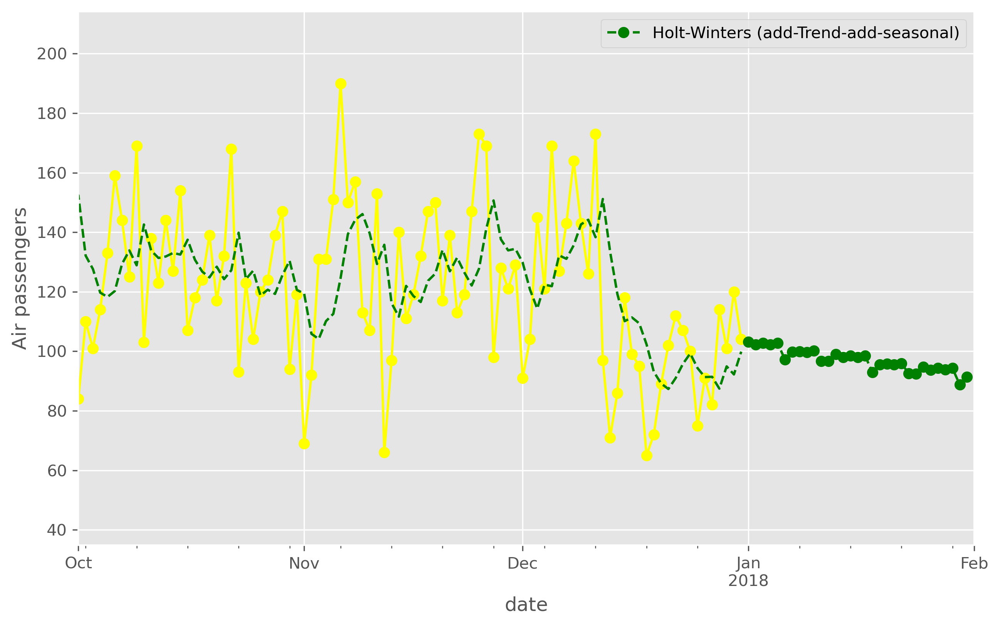

In [317]:
ax = tienda2_i28['sales'].plot(
    figsize=(10, 6),
    marker="o",
    color="yellow",
)

ax.set_ylabel("Air passengers")
ax.set_xlabel("Year")
fit1.fittedvalues.plot(ax=ax, style="--", color="green")
fit1.forecast(31).rename("Holt-Winters (add-Trend-add-seasonal)").plot(
    ax=ax, style="--", marker="o", color="green", legend=True
)

plt.xlim([datetime.date(2017, 10, 1), datetime.date(2018, 2, 1)])


plt.show()

In [318]:
evaluate_forecast(tienda2_i28['sales'], fit1.fittedvalues)

,r2_score,mean_absolute_error,median_absolute_error,mse,msle,rmse
0,0.262,19.988,16.640,643.292,0.053,25.363


In [322]:
fit1.forecast(31).sum().round(2)

3007.02

Debido a que las predicciones resultan de una forma de linea recta, se probarán con distintas acotaciones de periodos de tiempo: último año (2017) y últimos 6 meses.

**Utilizando solo 2017**

In [323]:
fit1 = ExponentialSmoothing(
    tienda2_i28[tienda2_i28['year']==2017]['sales'],
    freq='D',
    seasonal_periods=12,
    trend="add",
    seasonal="add",
    initialization_method="estimated",
).fit()

fit2 = ExponentialSmoothing(
    tienda2_i28[tienda2_i28['year']==2017]['sales'],
    freq='D',
    seasonal_periods=12,
    trend="add",
    seasonal="mul",
    initialization_method="estimated",
).fit()

fit3 = ExponentialSmoothing(
    tienda2_i28[tienda2_i28['year']==2017]['sales'],
    freq='D',
    seasonal_periods=12,
    trend="mul",
    seasonal="add",
    initialization_method="estimated",
).fit()

fit4 = ExponentialSmoothing(
    tienda2_i28[tienda2_i28['year']==2017]['sales'],
    freq='D',
    seasonal_periods=12,
    trend="mul",
    seasonal="mul",
    initialization_method="estimated",
).fit()

In [324]:
results2 = pd.DataFrame(
    index=["SSE", "AIC", "BIC"])

results2["Holt Trend-Add Seas-Add"] = [fit1.sse] + [fit1.aic] + [fit1.bic]
results2["Holt Trend-Add Seas-Mul"] = [fit2.sse] + [fit2.aic] + [fit2.bic]
results2["Holt Trend-Mul Seas-Add"] = [fit3.sse] + [fit3.aic] + [fit3.bic]
results2["Holt Trend-Mul Seas-Mul"] = [fit4.sse] + [fit4.aic] + [fit4.bic]

results2

,Holt Trend-Add Seas-Add,Holt Trend-Add Seas-Mul,Holt Trend-Mul Seas-Add,Holt Trend-Mul Seas-Mul
SSE,292776.827,296513.713,295835.850,293909.325
AIC,2472.853,2477.482,2476.647,2474.262
BIC,2535.251,2539.881,2539.045,2536.661


Las mejores métricas las tiene el modelo con tendencia aditiva y estacionalidad aditiva, igual que antes.

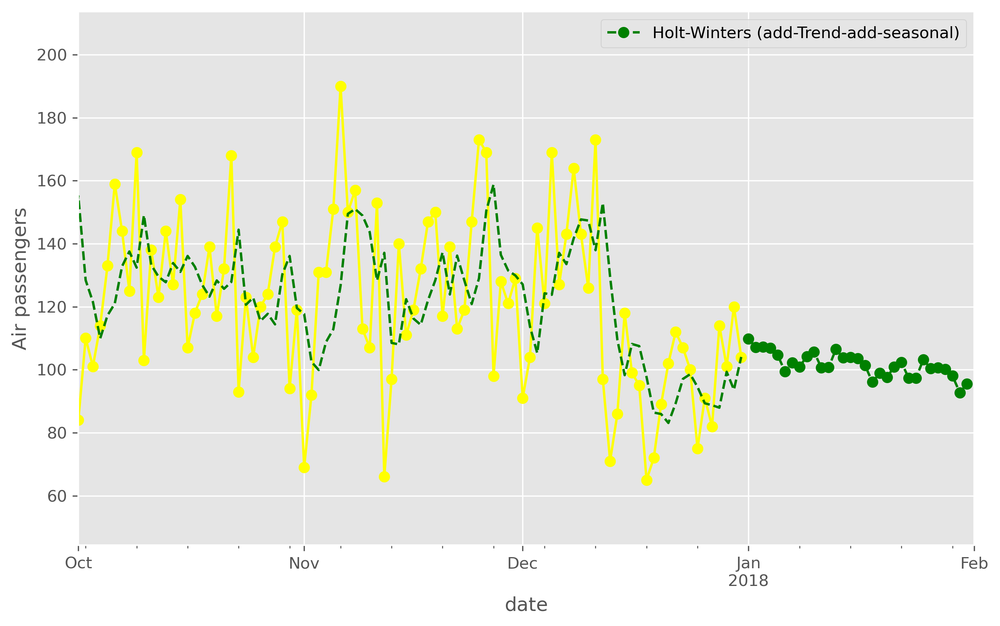

In [325]:
ax = tienda2_i28[tienda2_i28['year']==2017]['sales'].plot(
    figsize=(10, 6),
    marker="o",
    color="yellow",
)

ax.set_ylabel("Air passengers")
ax.set_xlabel("Year")
fit1.fittedvalues.plot(ax=ax, style="--", color="green")
fit1.forecast(31).rename("Holt-Winters (add-Trend-add-seasonal)").plot(
    ax=ax, style="--", marker="o", color="green", legend=True
)

plt.xlim([datetime.date(2017, 10, 1), datetime.date(2018, 2, 1)])


plt.show()

In [326]:
evaluate_forecast(tienda2_i28[tienda2_i28['year']==2017]['sales'], fit1.fittedvalues)

,r2_score,mean_absolute_error,median_absolute_error,mse,msle,rmse
0,0.146,22.314,18.861,802.128,0.053,28.322


In [327]:
fit1.forecast(31).sum().round(2)

3149.87

**Utilizando últimos 6 meses**

In [328]:
fit1 = ExponentialSmoothing(
    tienda2_i28[(tienda2_i28['year']==2017) & (tienda2_i28['month']>=6)]['sales'],
    freq='D',
    seasonal_periods=12,
    trend="add",
    seasonal="add",
    initialization_method="estimated",
).fit()

fit2 = ExponentialSmoothing(
    tienda2_i28[(tienda2_i28['year']==2017) & (tienda2_i28['month']>=6)]['sales'],
    freq='D',
    seasonal_periods=12,
    trend="add",
    seasonal="mul",
    initialization_method="estimated",
).fit()

fit3 = ExponentialSmoothing(
    tienda2_i28[(tienda2_i28['year']==2017) & (tienda2_i28['month']>=6)]['sales'],
    freq='D',
    seasonal_periods=12,
    trend="mul",
    seasonal="add",
    initialization_method="estimated",
).fit()

fit4 = ExponentialSmoothing(
    tienda2_i28[(tienda2_i28['year']==2017) & (tienda2_i28['month']>=6)]['sales'],
    freq='D',
    seasonal_periods=12,
    trend="mul",
    seasonal="mul",
    initialization_method="estimated",
).fit()

In [329]:
results2 = pd.DataFrame(
    index=["SSE", "AIC", "BIC"])

results2["Holt Trend-Add Seas-Add"] = [fit1.sse] + [fit1.aic] + [fit1.bic]
results2["Holt Trend-Add Seas-Mul"] = [fit2.sse] + [fit2.aic] + [fit2.bic]
results2["Holt Trend-Mul Seas-Add"] = [fit3.sse] + [fit3.aic] + [fit3.bic]
results2["Holt Trend-Mul Seas-Mul"] = [fit4.sse] + [fit4.aic] + [fit4.bic]

results2

,Holt Trend-Add Seas-Add,Holt Trend-Add Seas-Mul,Holt Trend-Mul Seas-Add,Holt Trend-Mul Seas-Mul
SSE,179747.777,179951.384,192786.040,185789.555
AIC,1472.933,1473.176,1487.919,1480.008
BIC,1526.789,1527.031,1541.775,1533.864


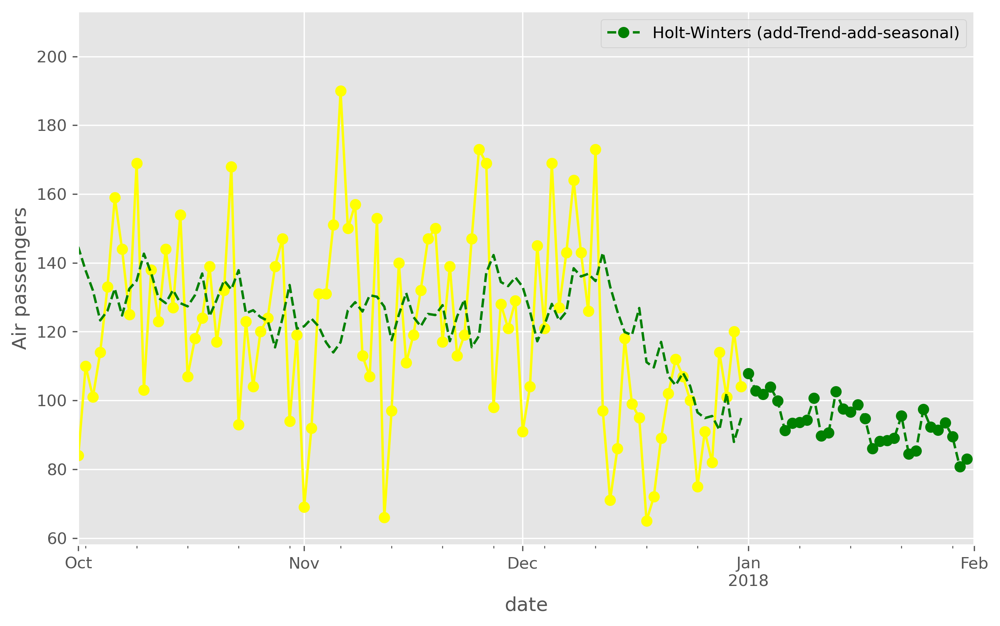

In [330]:
ax = tienda2_i28[(tienda2_i28['year']==2017) & (tienda2_i28['month']>=6)]['sales'].plot(
    figsize=(10, 6),
    marker="o",
    color="yellow",
)

ax.set_ylabel("Air passengers")
ax.set_xlabel("Year")
fit1.fittedvalues.plot(ax=ax, style="--", color="green")
fit1.forecast(31).rename("Holt-Winters (add-Trend-add-seasonal)").plot(
    ax=ax, style="--", marker="o", color="green", legend=True
)

plt.xlim([datetime.date(2017, 10, 1), datetime.date(2018, 2, 1)])


plt.show()

In [331]:
evaluate_forecast(tienda2_i28[(tienda2_i28['year']==2017) & (tienda2_i28['month']>=6)]['sales'], fit1.fittedvalues)

,r2_score,mean_absolute_error,median_absolute_error,mse,msle,rmse
0,0.039,23.515,21.735,839.943,0.054,28.982


In [334]:
Ventas_D_HW = fit1.forecast(31).sum().round(2)
Ventas_D_HW

2905.23

A medida que se ha ido considerando un periodo de tiempo más corto y reciente, las predicciones futuras se han visto con más variación que una simple linea horizontal. Esto es debido a la naturaleza del modelo de suavizamiento exponencial.

Así, por los gráficos y pruebas anteriores, para la predicción del siguiente mes será preferible usar los últimos 6 meses.

In [313]:
fit1.summary()

Dep. Variable:,sales,No. Observations:,214
Model:,ExponentialSmoothing,SSE,179747.777
Optimized:,True,AIC,1472.933
Trend:,Additive,BIC,1526.789
Seasonal:,Additive,AICC,1476.441
Seasonal Periods:,12,Date:,"Sun, 02 Jul 2023"
Box-Cox:,False,Time:,20:28:06
Box-Cox Coeff.:,None,,
,coeff,code,optimized
smoothing_level,0.1002107,alpha,True
smoothing_trend,0.0200613,beta,True


### Arima

AR

In [335]:
y = tienda2_i28[['sales']]

Transformación logarítmica

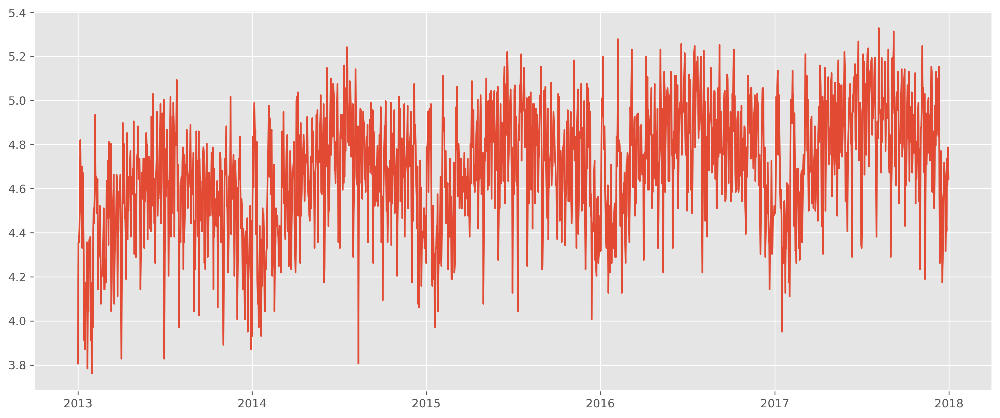

In [336]:
ts_log = np.log(y[['sales']])
plt.figure(figsize=(15,6))
plt.plot(ts_log)
plt.show()

Viendo Tendencia

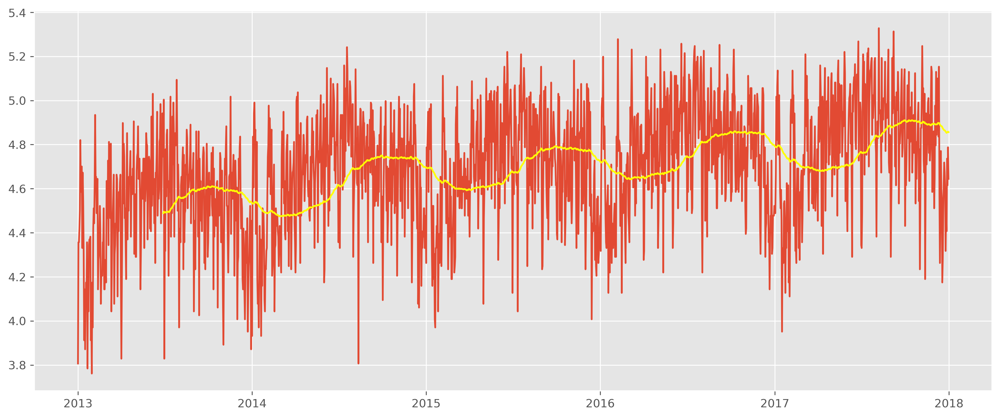

In [337]:
moving_avg = ts_log.rolling(180).mean()
plt.figure(figsize=(15,6))
plt.plot(ts_log)
plt.plot(moving_avg, color='yellow')
plt.show()

diferenciación

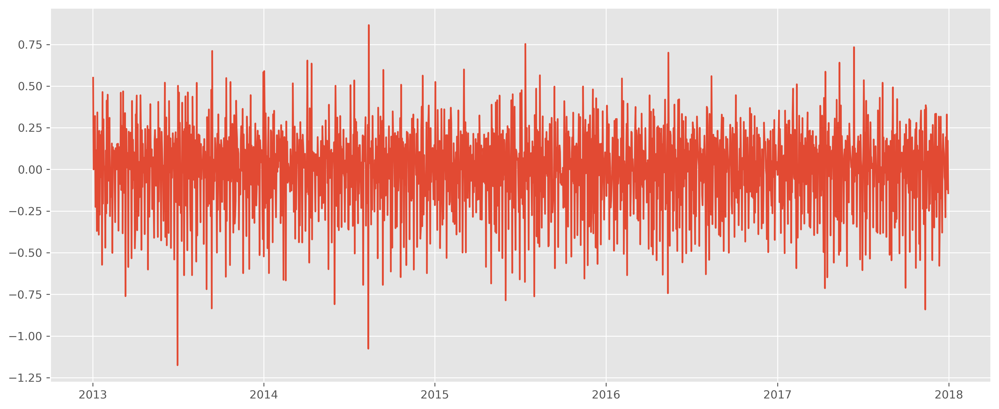

In [338]:
ts_log_diff = ts_log['sales'] - ts_log['sales'].shift()
plt.figure(figsize=(15,6))
plt.plot(ts_log_diff)
plt.show()

ahora la serie si parece tener un comportamiento estacionario en media y varianza

In [339]:
ts_log_diff = ts_log_diff.dropna()

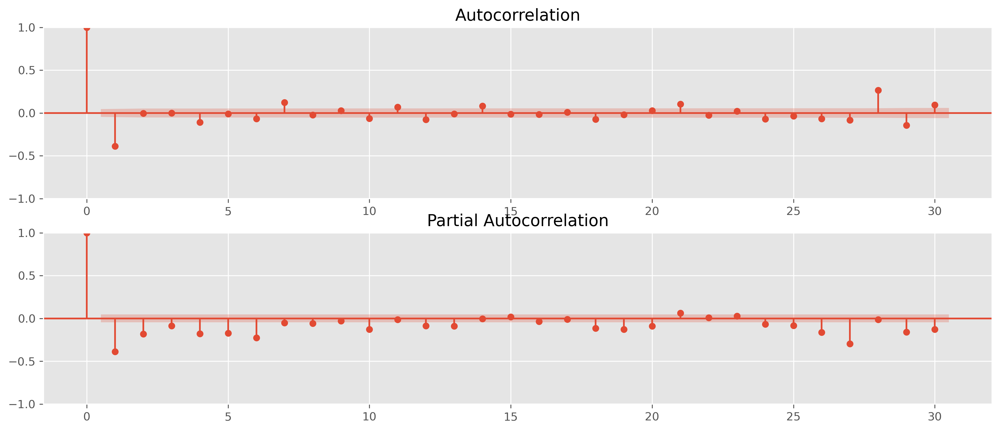

In [340]:
plt.figure(figsize=(15,6))
plt.subplot(211)
plot_acf(ts_log_diff, ax=plt.gca(), lags = 30)
plt.subplot(212)
plot_pacf(ts_log_diff, ax=plt.gca(), lags = 30)
plt.show()

2 rezagos

In [341]:
model = AutoReg(ts_log_diff, 2, old_names=False)
model_fit = model.fit()
print(model_fit.summary())

                            AutoReg Model Results                             
Dep. Variable:                  sales   No. Observations:                 1825
Model:                     AutoReg(2)   Log Likelihood                  61.276
Method:               Conditional MLE   S.D. of innovations              0.234
Date:                Sun, 02 Jul 2023   AIC                           -114.552
Time:                        20:31:10   BIC                            -92.519
Sample:                    01-04-2013   HQIC                          -106.424
                         - 12-31-2017                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0003      0.005      0.063      0.949      -0.010       0.011
sales.L1      -0.4609      0.023    -20.023      0.000      -0.506      -0.416
sales.L2      -0.1832      0.023     -7.968      0.0

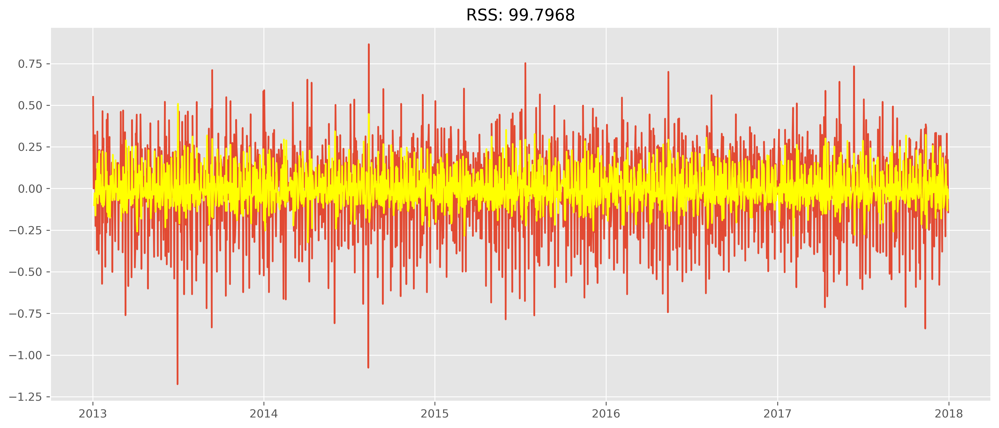

In [342]:
plt.figure(figsize=(15,6))
plt.plot(ts_log_diff)
plt.plot(model_fit.fittedvalues, color='yellow')
plt.title('RSS: %.4f'% np.nansum((model_fit.fittedvalues-ts_log_diff)**2))
plt.show()

valores predichos originales

In [343]:
predictions_ARIMA_diff = pd.Series(model_fit.fittedvalues, copy=True)
print (predictions_ARIMA_diff.head())

date
2013-01-04   -0.100
2013-01-05   -0.028
2013-01-06   -0.048
2013-01-07   -0.162
2013-01-08    0.045
dtype: float64


In [344]:
predictions_ARIMA_diff_cumsum = predictions_ARIMA_diff.cumsum()
print (predictions_ARIMA_diff_cumsum.head())

date
2013-01-04   -0.100
2013-01-05   -0.129
2013-01-06   -0.177
2013-01-07   -0.339
2013-01-08   -0.294
dtype: float64


In [345]:
predictions_ARIMA_log = pd.Series(ts_log.sales.iloc[0], index=ts_log.index)
predictions_ARIMA_log = predictions_ARIMA_log.add(predictions_ARIMA_diff_cumsum,fill_value=0)
predictions_ARIMA_log.head()

date
2013-01-01   3.807
2013-01-02   3.807
2013-01-03   3.807
2013-01-04   3.706
2013-01-05   3.678
dtype: float64

In [346]:
predictions_ARIMA = np.exp(predictions_ARIMA_log)
predictions_ARIMA

date
2013-01-01   45.000
2013-01-02   45.000
2013-01-03   45.000
2013-01-04   40.700
2013-01-05   39.565
              ...  
2017-12-27   71.879
2017-12-28   72.813
2017-12-29   63.782
2017-12-30   63.514
2017-12-31   60.000
Length: 1826, dtype: float64

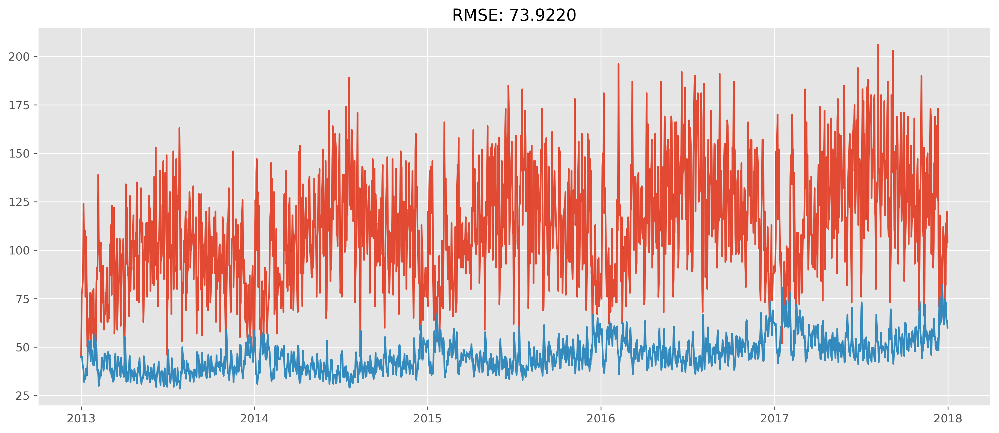

In [347]:
plt.figure(figsize=(15,6))
plt.plot(y.sales)
plt.plot(predictions_ARIMA)
plt.title('RMSE: %.4f'% np.sqrt(np.nansum((predictions_ARIMA-y.sales)**2)/len(y.sales)))
plt.show()

In [348]:
evaluate_forecast(y.sales, predictions_ARIMA)

,r2_score,mean_absolute_error,median_absolute_error,mse,msle,rmse
0,-5.271,66.812,65.892,5464.459,0.867,73.922


las métricas podrían mejorar

MA

In [349]:
model = ARIMA(ts_log_diff, order=(0, 0, 9)) 
model_fit = model.fit()

In [350]:
model_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                  sales   No. Observations:                 1825
Model:                 ARIMA(0, 0, 9)   Log Likelihood                 230.544
Date:                Sun, 02 Jul 2023   AIC                           -439.087
Time:                        20:31:16   BIC                           -378.485
Sample:                    01-02-2013   HQIC                          -416.732
                         - 12-31-2017                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0002      0.000      0.521      0.602      -0.001       0.001
ma.L1         -0.6361      0.024    -26.214      0.000      -0.684      -0.589
ma.L2         -0.0816      0.030     -2.705      0.007      -0.141      -0.022
ma.L3         -0.0732      0.030     -2.436      0.015      -0.132      -0.014
ma.L4         -0.1884      0.030     -6.371      0.000      -0.246      -0.130
ma.L5          0.0090      0.029      0.307      0.759      -0.048       0.066
ma.L6         -0.0391      0.028     -1.392      0.164      -0.094       0.016
ma.L7          0.1427      0.028      5.007      0.000       0.087       0.199
ma.L8         -0.0563      0.030     -1.898      0.058      -0.115       0.002
ma.L9         -0.0083      0.025     -0.331      0.741      -0.058       0.041
sigma2         0.0454      0.001     31.442      0.000       0.043       0.048
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):               132.99
Prob(Q):                              0.94   Prob(JB):                         0.00
Heteroskedasticity (H):               0.91   Skew:                            -0.58
Prob(H) (two-sided):                  0.26   Kurtosis:                         3.64
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

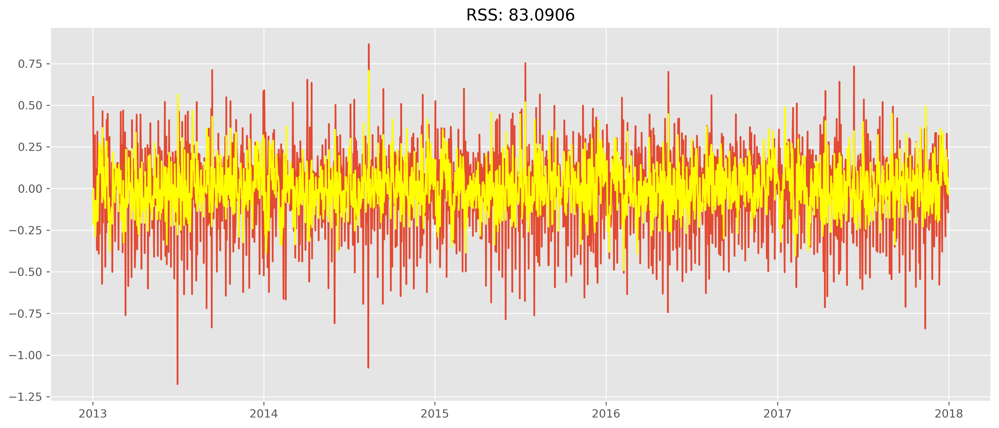

In [351]:
plt.figure(figsize=(15,6))
plt.plot(ts_log_diff)
plt.plot(model_fit.fittedvalues, color='yellow')
plt.title('RSS: %.4f'% np.nansum((model_fit.fittedvalues-ts_log_diff)**2))
plt.show()

ARMA

In [352]:
model = ARIMA(ts_log_diff, order=(2,0,9))
model_fit = model.fit()

In [353]:
model_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                  sales   No. Observations:                 1825
Model:                 ARIMA(2, 0, 9)   Log Likelihood                 230.751
Date:                Sun, 02 Jul 2023   AIC                           -435.502
Time:                        20:31:20   BIC                           -363.880
Sample:                    01-02-2013   HQIC                          -409.082
                         - 12-31-2017                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0002      0.000      0.508      0.611      -0.001       0.001
ar.L1         -0.5042     11.248     -0.045      0.964     -22.550      21.542
ar.L2         -0.0255      4.198     -0.006      0.995      -8.254       8.203
ma.L1         -0.1311     11.250     -0.012      0.991     -22.181      21.918
ma.L2         -0.3726      2.979     -0.125      0.900      -6.212       5.467
ma.L3         -0.1274      3.541     -0.036      0.971      -7.068       6.813
ma.L4         -0.2307      1.133     -0.204      0.839      -2.452       1.991
ma.L5         -0.1024      2.469     -0.041      0.967      -4.941       4.736
ma.L6         -0.0406      0.849     -0.048      0.962      -1.704       1.623
ma.L7          0.1203      0.401      0.300      0.764      -0.665       0.906
ma.L8         -0.0022      1.399     -0.002      0.999      -2.745       2.741
ma.L9         -0.0067      0.233     -0.029      0.977      -0.463       0.450
sigma2         0.0454      0.001     30.919      0.000       0.043       0.048
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):               133.65
Prob(Q):                              0.92   Prob(JB):                         0.00
Heteroskedasticity (H):               0.92   Skew:                            -0.58
Prob(H) (two-sided):                  0.29   Kurtosis:                         3.64
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

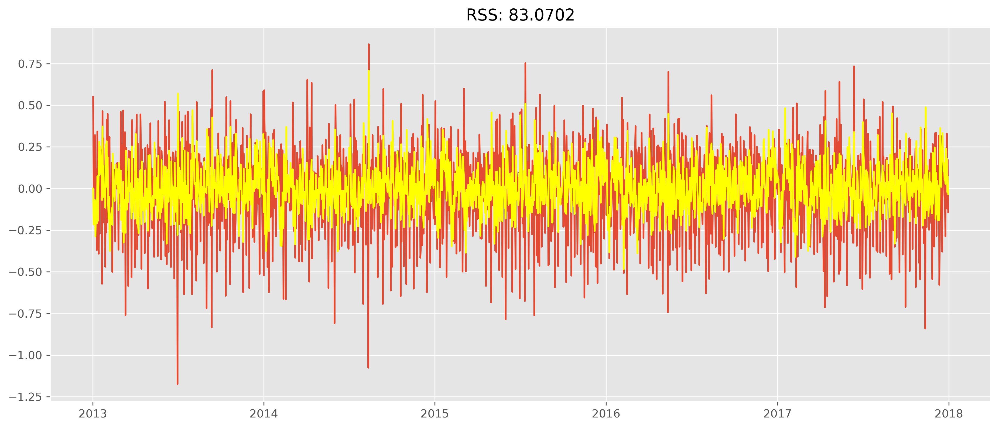

In [354]:
plt.figure(figsize=(15,6))
plt.plot(ts_log_diff)
plt.plot(model_fit.fittedvalues, color='yellow')
plt.title('RSS: %.4f'% np.nansum((model_fit.fittedvalues-ts_log_diff)**2))
plt.show()

ARIMA

solo se usará el último año

In [355]:
y = y[y.index.year==2017]

In [356]:
ts = y.sales - y.sales.shift()
ts.dropna(inplace=True)

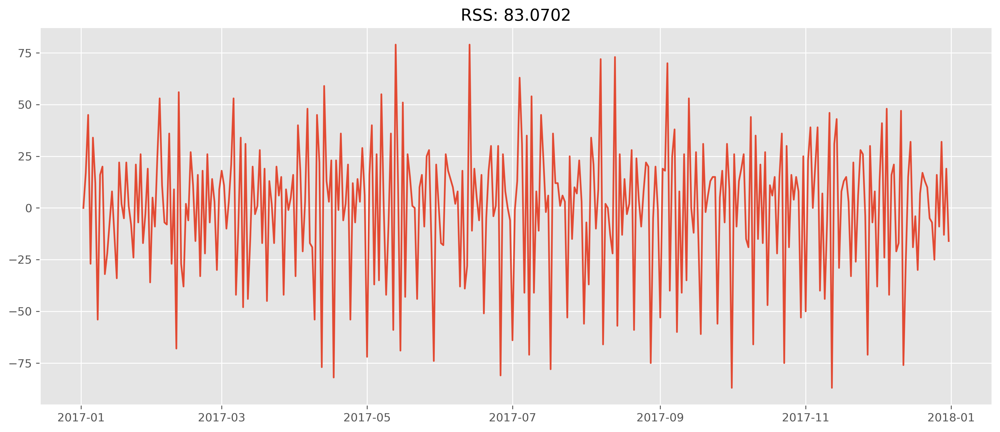

In [357]:
plt.figure(figsize=(15,6))
plt.plot(ts)
plt.title('RSS: %.4f'% np.nansum((model_fit.fittedvalues-ts_log_diff)**2))
plt.show()

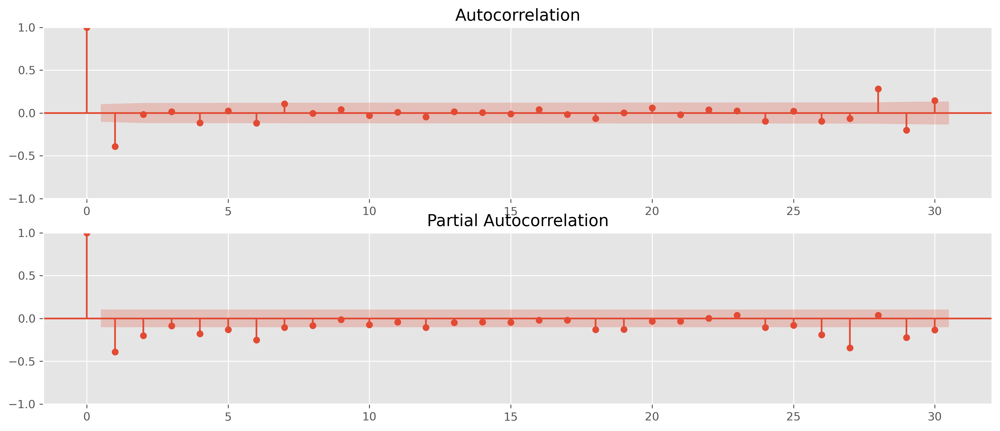

In [358]:
plt.figure(figsize=(15,6))
plt.subplot(211)
plot_acf(ts, ax=plt.gca(),lags=30)
plt.subplot(212)
plot_pacf(ts, ax=plt.gca(),lags=30)
plt.show()

<AxesSubplot:xlabel='date'>

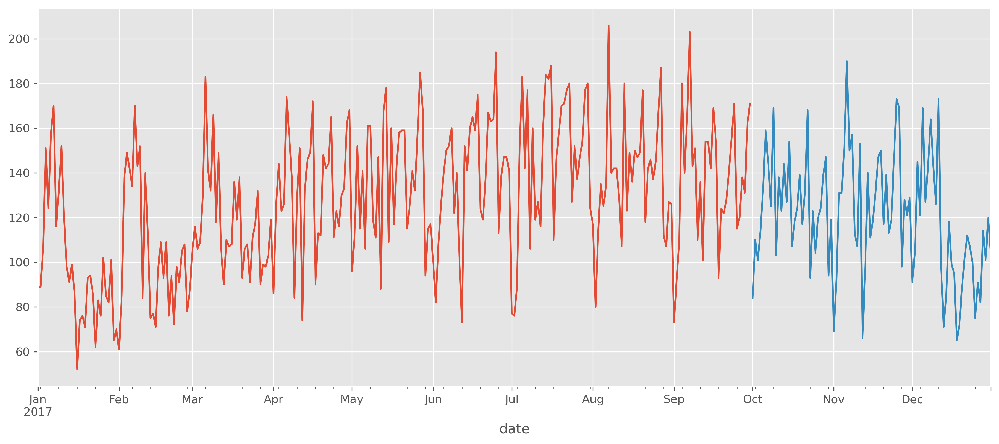

In [359]:
train = y[['sales']][:int(0.75*(len(y)))]
valid = y[['sales']][int(0.75*(len(y))):]

#plotting the data
plt.figure(figsize=(15,6))
train['sales'].plot()
valid['sales'].plot()

In [360]:
model = pm.auto_arima(train, trace=True, error_action='ignore', suppress_warnings=True)
model.fit(train)

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2653.319, Time=0.01 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2614.382, Time=0.04 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2590.990, Time=0.04 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2651.344, Time=0.01 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.15 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=2571.024, Time=0.09 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.24 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.11 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.30 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=2571.392, Time=0.05 sec

Best model:  ARIMA(0,1,2)(0,0,0)[0] intercept
Total fit time: 1.253 seconds


ARIMA(order=(0, 1, 2), scoring_args={}, suppress_warnings=True)

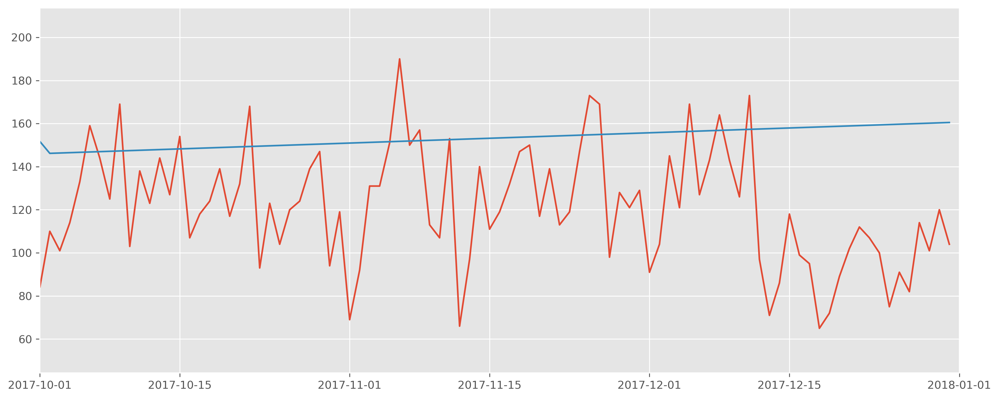

In [361]:
forecast = model.predict(n_periods=len(valid))
forecast = pd.DataFrame(forecast,index = valid.index,columns=['Prediction'])

plt.figure(figsize=(15,6))
#plot the predictions for validation set
plt.plot(y.sales, label='Train')
#plt.plot(valid, label='Valid')
plt.plot(forecast, label='Prediction')
plt.xlim([datetime.date(2017, 10, 1), datetime.date(2018, 1, 1)])
plt.show()

incorporando estacionalidad

In [362]:
model = pm.auto_arima(train, trace=True, error_action='ignore', suppress_warnings=True, seasonal=True, m=12, stepwise=True)
model.fit(train)

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[12] intercept   : AIC=inf, Time=0.77 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=2653.319, Time=0.01 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=2615.025, Time=0.10 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=2589.912, Time=0.13 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=2651.344, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=2590.990, Time=0.04 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=inf, Time=0.32 sec
 ARIMA(0,1,1)(0,0,2)[12] intercept   : AIC=2582.030, Time=0.40 sec
 ARIMA(0,1,1)(1,0,2)[12] intercept   : AIC=2579.375, Time=0.75 sec
 ARIMA(0,1,1)(2,0,2)[12] intercept   : AIC=inf, Time=1.00 sec
 ARIMA(0,1,1)(2,0,1)[12] intercept   : AIC=2579.383, Time=0.63 sec
 ARIMA(0,1,0)(1,0,2)[12] intercept   : AIC=2650.211, Time=0.51 sec
 ARIMA(1,1,1)(1,0,2)[12] intercept   : AIC=inf, Time=1.77 sec
 ARIMA(0,1,2)(1,0,2)[12] intercept   : AIC=2562.997, Time=1.21 sec
 ARIMA(0,1,2)(0,0,2)[12] intercept   : 

ARIMA(order=(0, 1, 2), scoring_args={}, seasonal_order=(1, 0, 2, 12),
      suppress_warnings=True)

In [363]:
start_index = valid.index.min()
end_index = valid.index.max()

#Predictions
pred = model.predict()

In [364]:
pred = model.predict(n_periods=len(valid))
pred = pd.DataFrame(pred,index = valid.index,columns=['Prediction'])

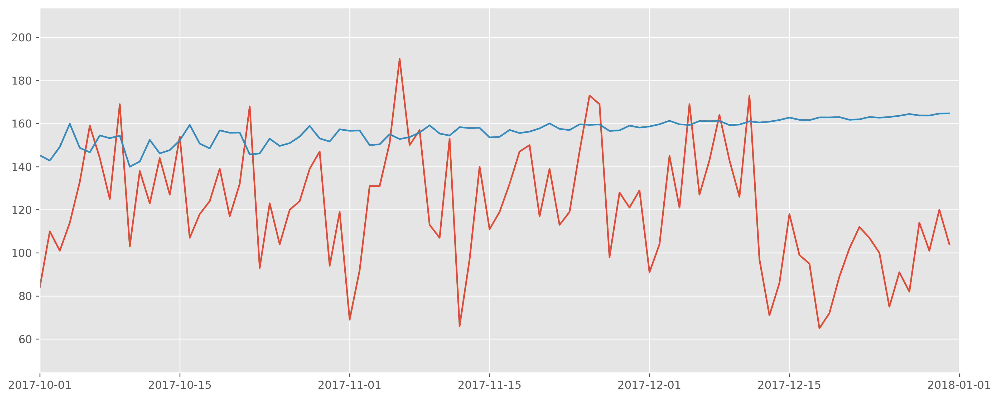

In [365]:
forecast = model.predict(n_periods=len(valid))
forecast = pd.DataFrame(forecast,index = valid.index,columns=['Prediction'])

plt.figure(figsize=(15,6))
#plot the predictions for validation set
plt.plot(y.sales, label='Train')
#plt.plot(valid, label='Valid')
plt.plot(forecast, label='Prediction')
plt.xlim([datetime.date(2017, 10, 1), datetime.date(2018, 1, 1)])
plt.show()

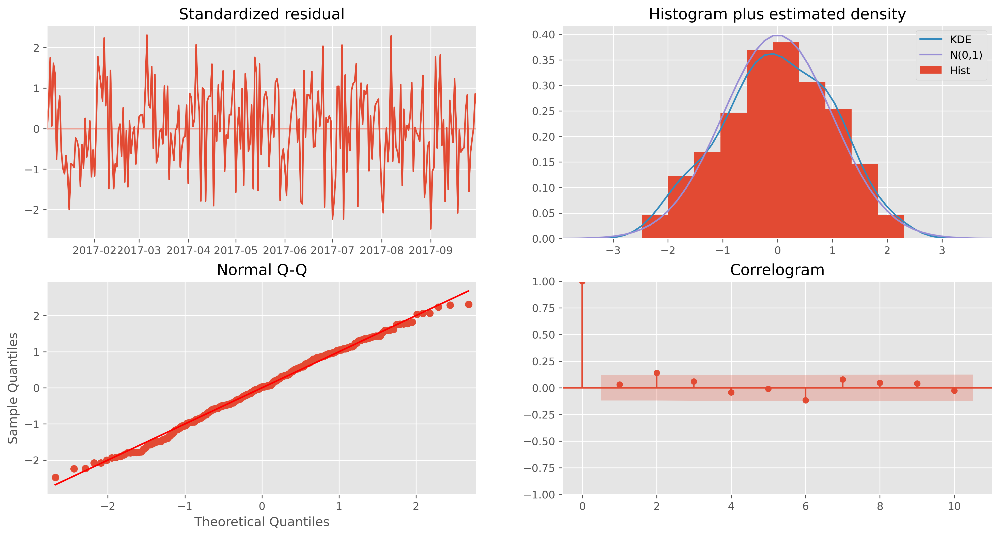

In [366]:
model.plot_diagnostics(figsize=(16, 8))
plt.show()

El modelo se comporta bien en térmninos de normalidad de residuos, pero no logra adaptarse bien a los movimientos de la serie y su volatilidad, a diferencia del Prophet y suavizamiento exponencial.

In [368]:
train = y[['sales']]

In [369]:
model = pm.auto_arima(train, trace=True, error_action='ignore', suppress_warnings=True, seasonal=True, m=12, stepwise=True)
model.fit(train)

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[12] intercept   : AIC=inf, Time=0.98 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=3550.455, Time=0.01 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=3493.215, Time=0.13 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=3455.849, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=3548.456, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : AIC=3456.587, Time=0.04 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : AIC=inf, Time=0.68 sec
 ARIMA(0,1,1)(0,0,2)[12] intercept   : AIC=3443.556, Time=0.51 sec
 ARIMA(0,1,1)(1,0,2)[12] intercept   : AIC=3443.769, Time=0.70 sec
 ARIMA(0,1,0)(0,0,2)[12] intercept   : AIC=3549.009, Time=0.31 sec
 ARIMA(1,1,1)(0,0,2)[12] intercept   : AIC=3422.047, Time=0.67 sec
 ARIMA(1,1,1)(0,0,1)[12] intercept   : AIC=3427.195, Time=0.25 sec
 ARIMA(1,1,1)(1,0,2)[12] intercept   : AIC=3422.255, Time=1.13 sec
 ARIMA(1,1,1)(1,0,1)[12] intercept   : AIC=inf, Time=0.82 sec
 ARIMA(1,1,0)(0,0,2)[12] intercept

ARIMA(order=(2, 1, 1), scoring_args={}, seasonal_order=(0, 0, 2, 12),
      suppress_warnings=True, with_intercept=False)

In [377]:
start_index = pd.Timestamp('2018-01-01')
end_index = pd.Timestamp('2018-01-31')

#Predictions
pred = model.predict()

In [378]:
pred = model.predict(n_periods=31)
# pred = pd.DataFrame(pred,index = valid.index,columns=['Prediction'])

In [381]:
Ventas_D_SARIMAX = pred.sum().round(2)
Ventas_D_SARIMAX

3532.33

## Probando con Data Mensual

In [382]:
tienda2_i28_Mensual = tienda2_i28.groupby([pd.Grouper(freq='M')])[['sales']].sum().reset_index()
tienda2_i28_Mensual.index=tienda2_i28_Mensual['date']

In [383]:
tienda2_i28_Mensual = crear_vars(tienda2_i28_Mensual)

In [384]:
tienda2_i28_Mensual.head()

,date,sales,quarter,month,year,dayofyear,dayofmonth,weekofyear,dayofweek,is_weekday
date,,,,,,,,,,
2013-01-31,2013-01-31,2281,1,1,2013,31,31,5,3,4
2013-02-28,2013-02-28,2286,1,2,2013,59,28,9,3,4
2013-03-31,2013-03-31,2809,1,3,2013,90,31,13,6,7
2013-04-30,2013-04-30,2883,2,4,2013,120,30,18,1,2
2013-05-31,2013-05-31,3168,2,5,2013,151,31,22,4,5


In [385]:
fig = px.line(tienda2_i28_Mensual, x="date", y=['sales'],
            title="Ventas Tienda 2 - item 28 | Mensual",
            template = 'plotly_dark'
            ).update_layout(
            xaxis_title="Fecha", yaxis_title="Ventas"
)
fig.show()

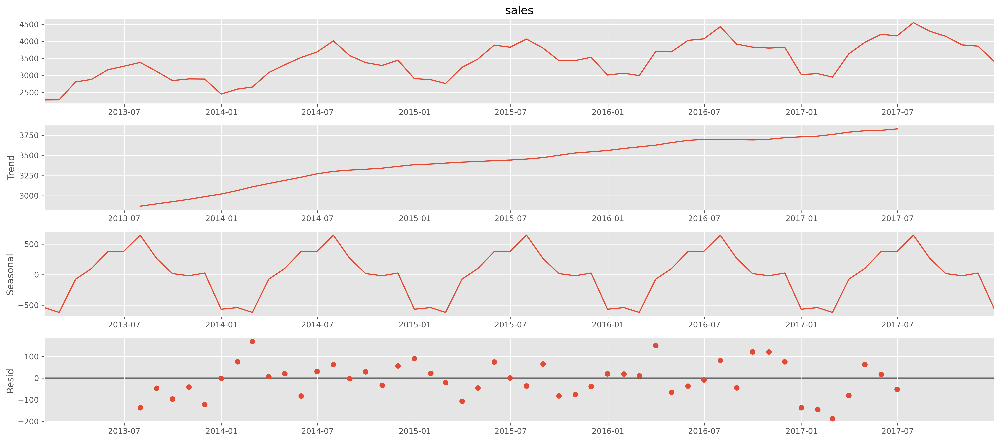

In [386]:
matplotlib.rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(tienda2_i28_Mensual['sales']) #model='multiplicative')
fig = decomposition.plot()
plt.show()

Esta serie en frecuencia mensual no parece ser estacionaria: tiene una tendencia creciente notoria y una estacionalidad marcada alrededor de agosto de cada año. Por otra parte, los residuos parecen tener una patrón.

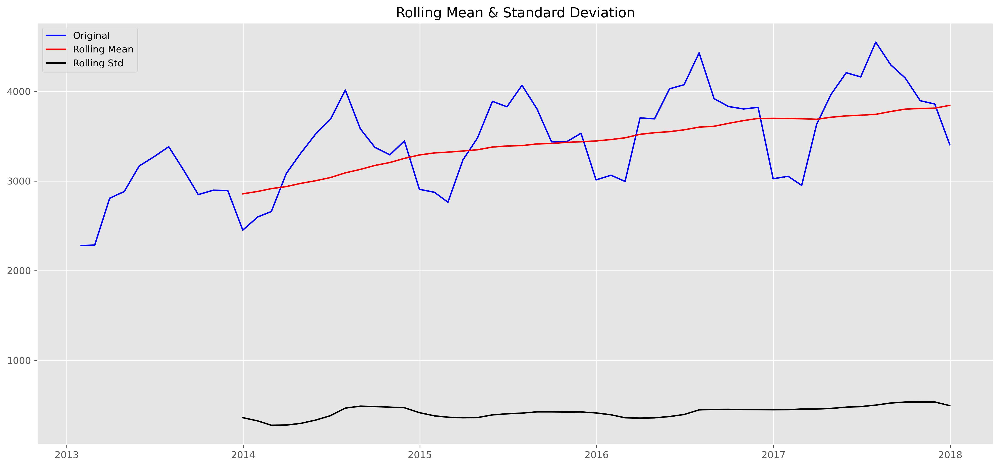

In [387]:
rolmean = tienda2_i28_Mensual['sales'].rolling(12).mean()
rolstd = tienda2_i28_Mensual['sales'].rolling(12).std()

#Graficando estadísticas continuas
orig = plt.plot(tienda2_i28_Mensual['sales'], color='blue',label='Original')
mean = plt.plot(rolmean, color='red', label='Rolling Mean')
std = plt.plot(rolstd, color='black', label = 'Rolling Std')
plt.legend(loc='best')
plt.title('Rolling Mean & Standard Deviation')
plt.show(block=False)

Se aprecia una tendencia no constante

In [388]:
print ('Results of Dickey-Fuller Test:')
dftest = adfuller(tienda2_i28_Mensual['sales'], autolag='AIC', regression='ctt')
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
for key,value in dftest[4].items():
    dfoutput['Critical Value (%s)'%key] = value
print (dfoutput)

Results of Dickey-Fuller Test:
Test Statistic                -1.366
p-value                        0.962
#Lags Used                    11.000
Number of Observations Used   48.000
Critical Value (1%)           -4.631
Critical Value (5%)           -3.962
Critical Value (10%)          -3.632
dtype: float64


La prueba Dickey-Fuller aumentada considerando constante y tendencia linear y cuadrática confirma que la serie no es estacionaria

### Prophet

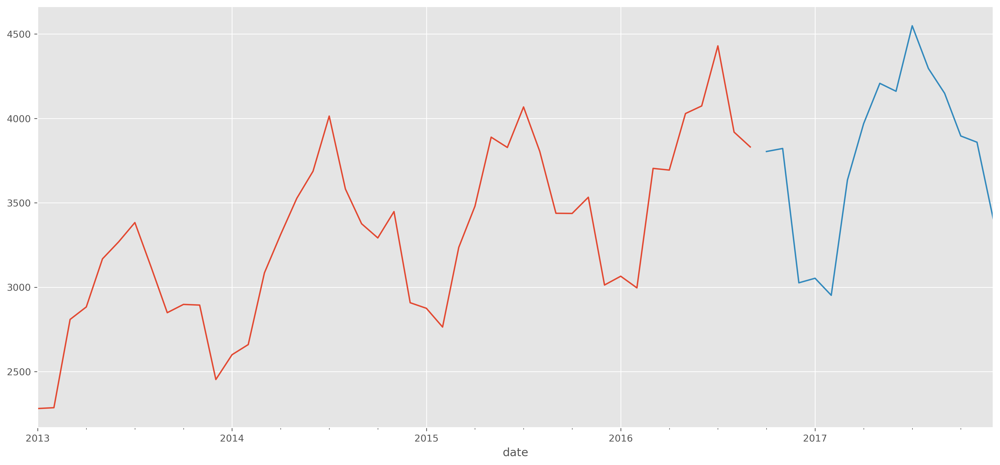

In [389]:
train = tienda2_i28_Mensual[['sales']][:int(0.75*(len(tienda2_i28_Mensual['sales'])))]
valid = tienda2_i28_Mensual[['sales']][int(0.75*(len(tienda2_i28_Mensual['sales']))):]

#plotting the data
train['sales'].plot()
valid['sales'].plot()
plt.show()

In [390]:
train_prophet = pd.DataFrame()
train_prophet['ds'] = train.index
train_prophet['y'] = train['sales'].values

In [391]:
model = Prophet(yearly_seasonality=True, seasonality_mode = 'multiplicative')
model.fit(train_prophet)

20:37:14 - cmdstanpy - INFO - Chain [1] start processing
20:37:14 - cmdstanpy - INFO - Chain [1] done processing


In [392]:
future = model.make_future_dataframe(periods = valid.shape[0], freq = 'M') 
future.head()

,ds
0,2013-01-31
1,2013-02-28
2,2013-03-31
3,2013-04-30
4,2013-05-31


In [393]:
forecast = model.predict(future)
forecast[['ds', 'yhat']].head()

,ds,yhat
0,2013-01-31,2290.055
1,2013-02-28,2300.003
2,2013-03-31,2787.736
3,2013-04-30,2868.036
4,2013-05-31,3134.663


In [394]:
fig = plot_plotly(model, forecast)

fig.update_layout(
    autosize=False,
    width=1400,
    height=600)

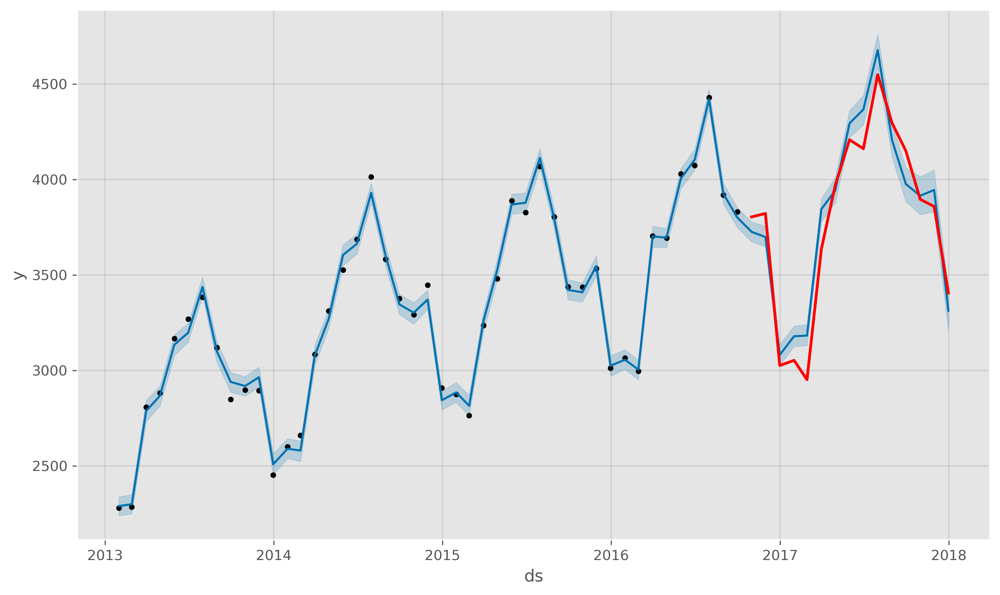

In [395]:
fig = model.plot(forecast)

plt.plot(valid, label='Valid', color = 'red', linewidth = 2)

# plt.xlim([datetime.date(2017, 5, 1), datetime.date(2017, 12, 31)])

plt.show()

In [396]:
fig = plot_components_plotly(model, forecast)
fig.update_layout(
    autosize=False,
    width=1400,
    height=600)

In [397]:
evaluate_forecast(tienda2_i28_Mensual['sales'], forecast['yhat'])

,r2_score,mean_absolute_error,median_absolute_error,mse,msle,rmse
0,0.981,52.987,29.746,5564.373,0.000,74.595


Prophet muestra un buen ajuste tanto visual como en las métricas

Prediciendo el siguiente mes

In [398]:
train = tienda2_i28_Mensual[['sales']]


train_prophet = pd.DataFrame()
train_prophet['ds'] = train.index
train_prophet['y'] = train['sales'].values

In [399]:
model = Prophet(yearly_seasonality=True, seasonality_mode = 'multiplicative')
model.fit(train_prophet)

20:37:22 - cmdstanpy - INFO - Chain [1] start processing
20:37:22 - cmdstanpy - INFO - Chain [1] done processing


In [400]:
future = model.make_future_dataframe(periods = 1, freq = 'M') 
future

,ds
0,2013-01-31
1,2013-02-28
2,2013-03-31
3,2013-04-30
4,2013-05-31
...,...
56,2017-09-30
57,2017-10-31
58,2017-11-30
59,2017-12-31


In [401]:
forecast = model.predict(future)

In [402]:
future['ds'].iloc[-1-31]

Timestamp('2015-06-30 00:00:00')

In [403]:
future['ds'].iloc[-1]

Timestamp('2018-01-31 00:00:00')

Text(0.5, 1.0, 'Predicción del Mes siguiente del item 28 de la tienda 2 con Prophet')

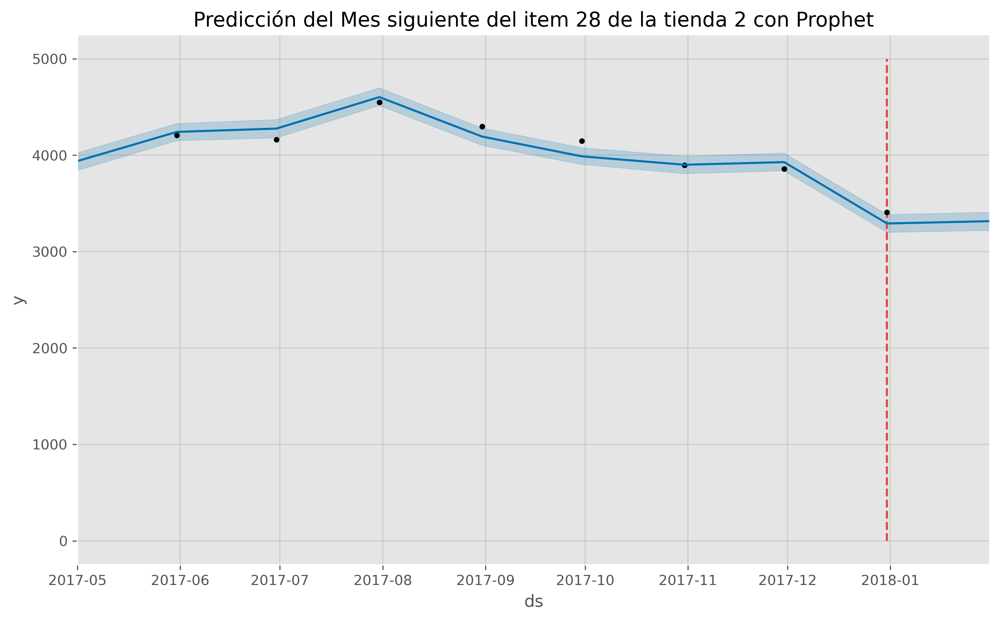

In [404]:
fig = model.plot(forecast)

plt.xlim([datetime.date(2017, 5, 1), datetime.date(2018, 1, 31)])

plt.vlines(datetime.date(2017, 12, 31 ), ymin=0, ymax=5000, linestyles='dashed')

plt.title('Predicción del Mes siguiente del item 28 de la tienda 2 con Prophet')

Valor del siguiente mes predicho con Prophet

In [405]:
forecast[forecast['ds']=='2018-01-31'][['ds','yhat']]

,ds,yhat
60,2018-01-31,3315.103


In [409]:
Ventas_M_Prophet = forecast[forecast['ds']=='2018-01-31']['yhat'].values[0].round(2)
Ventas_M_Prophet

3315.1

### Suavizamiento Exponencial

Holt-Winters

In [410]:
fit1 = ExponentialSmoothing(
    tienda2_i28_Mensual['sales'],
    freq='M',
    seasonal_periods=12,
    trend="add",
    seasonal="add",
    initialization_method="estimated",
).fit()

fit2 = ExponentialSmoothing(
    tienda2_i28_Mensual['sales'],
    freq='M',
    seasonal_periods=12,
    trend="add",
    seasonal="mul",
    initialization_method="estimated",
).fit()

fit3 = ExponentialSmoothing(
    tienda2_i28_Mensual['sales'],
    freq='M',
    seasonal_periods=12,
    trend="mul",
    seasonal="add",
    initialization_method="estimated",
).fit()

fit4 = ExponentialSmoothing(
    tienda2_i28_Mensual['sales'],
    freq='M',
    seasonal_periods=12,
    trend="mul",
    seasonal="mul",
    initialization_method="estimated",
).fit()

In [411]:
results = pd.DataFrame(
    index=["SSE", "AIC", "BIC"])

results["Holt Trend-Add Seas-Add"] = [fit1.sse] + [fit1.aic] + [fit1.bic]
results["Holt Trend-Add Seas-Mul"] = [fit2.sse] + [fit2.aic] + [fit2.bic]
results["Holt Trend-Mul Seas-Add"] = [fit3.sse] + [fit3.aic] + [fit3.bic]
results["Holt Trend-Mul Seas-Mul"] = [fit4.sse] + [fit4.aic] + [fit4.bic]

results

,Holt Trend-Add Seas-Add,Holt Trend-Add Seas-Mul,Holt Trend-Mul Seas-Add,Holt Trend-Mul Seas-Mul
SSE,527971.710,449474.799,574359.332,489581.590
AIC,576.947,567.289,582.000,572.418
BIC,610.457,600.799,615.509,605.927


Las mejores métricas las tiene el modelo con tendencia aditiva y estacionalidad multiplicativa

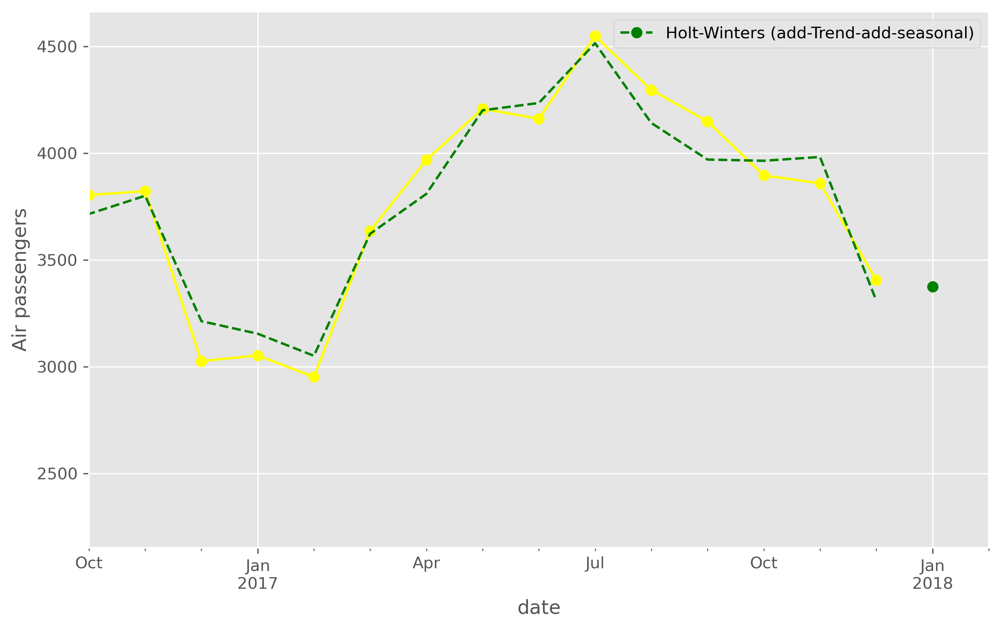

In [412]:
ax = tienda2_i28_Mensual['sales'].plot(
    figsize=(10, 6),
    marker="o",
    color="yellow",
)

ax.set_ylabel("Air passengers")
ax.set_xlabel("Year")
fit2.fittedvalues.plot(ax=ax, style="--", color="green")
fit2.forecast(1).rename("Holt-Winters (add-Trend-add-seasonal)").plot(
    ax=ax, style="--", marker="o", color="green", legend=True
)

plt.xlim([datetime.date(2016, 10, 1), datetime.date(2018, 2, 1)])


plt.show()

In [413]:
evaluate_forecast(tienda2_i28_Mensual['sales'], fit2.fittedvalues)

,r2_score,mean_absolute_error,median_absolute_error,mse,msle,rmse
0,0.974,71.788,59.286,7491.247,0.001,86.552


Predicción del siguiente mes

In [414]:
fit2.forecast(1).rename("Holt-Winters (add-Trend-add-seasonal)")

2018-01-31   3375.516
Freq: M, Name: Holt-Winters (add-Trend-add-seasonal), dtype: float64

**Utilizando último año**

In [415]:
fit1 = ExponentialSmoothing(
    tienda2_i28_Mensual[(tienda2_i28_Mensual['year']==2017)]['sales'],
    freq='M',
    seasonal_periods=3,
    trend="add",
    seasonal="add",
    initialization_method="estimated",
).fit()

fit2 = ExponentialSmoothing(
    tienda2_i28_Mensual[(tienda2_i28_Mensual['year']==2017)]['sales'],
    freq='M',
    seasonal_periods=3,
    trend="add",
    seasonal="mul",
    initialization_method="estimated",
).fit()

fit3 = ExponentialSmoothing(
    tienda2_i28_Mensual[(tienda2_i28_Mensual['year']==2017)]['sales'],
    freq='M',
    seasonal_periods=3,
    trend="mul",
    seasonal="add",
    initialization_method="estimated",
).fit()

fit4 = ExponentialSmoothing(
    tienda2_i28_Mensual[(tienda2_i28_Mensual['year']==2017)]['sales'],
    freq='M',
    seasonal_periods=3,
    trend="mul",
    seasonal="mul",
    initialization_method="estimated",
).fit()

In [416]:
results = pd.DataFrame(
    index=["SSE", "AIC", "BIC"])

results["Holt Trend-Add Seas-Add"] = [fit1.sse] + [fit1.aic] + [fit1.bic]
results["Holt Trend-Add Seas-Mul"] = [fit2.sse] + [fit2.aic] + [fit2.bic]
results["Holt Trend-Mul Seas-Add"] = [fit3.sse] + [fit3.aic] + [fit3.bic]
results["Holt Trend-Mul Seas-Mul"] = [fit4.sse] + [fit4.aic] + [fit4.bic]

results

,Holt Trend-Add Seas-Add,Holt Trend-Add Seas-Mul,Holt Trend-Mul Seas-Add,Holt Trend-Mul Seas-Mul
SSE,1221436.406,1346912.826,1609767.423,1338093.419
AIC,152.368,153.541,155.680,153.462
BIC,155.762,156.935,159.075,156.857


Las mejores métricas las tiene el modelo con tendencia aditiva y estacionalidad aditiva

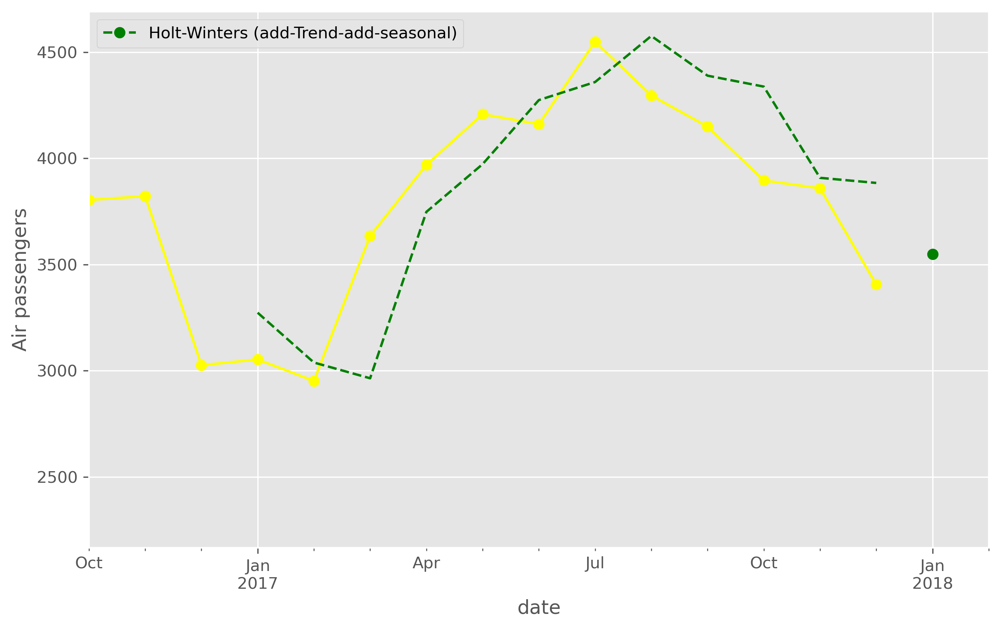

In [417]:
ax = tienda2_i28_Mensual['sales'].plot(
    figsize=(10, 6),
    marker="o",
    color="yellow",
)

ax.set_ylabel("Air passengers")
ax.set_xlabel("Year")
fit1.fittedvalues.plot(ax=ax, style="--", color="green")
fit1.forecast(1).rename("Holt-Winters (add-Trend-add-seasonal)").plot(
    ax=ax, style="--", marker="o", color="green", legend=True
)

plt.xlim([datetime.date(2016, 10, 1), datetime.date(2018, 2, 1)])


plt.show()

In [418]:
evaluate_forecast(tienda2_i28_Mensual[(tienda2_i28_Mensual['year']==2017)]['sales'], fit1.fittedvalues)

,r2_score,mean_absolute_error,median_absolute_error,mse,msle,rmse
0,0.548,268.873,228.315,101786.367,0.008,319.040


Predicción del siguiente mes

In [419]:
fit1.forecast(1).rename("Holt-Winters (add-Trend-add-seasonal)")

2018-01-31   3548.240
Freq: M, Name: Holt-Winters (add-Trend-add-seasonal), dtype: float64

In [423]:
Ventas_M_HW = fit1.forecast(1).rename("Holt-Winters (add-Trend-add-seasonal)")[0].round(2)
Ventas_M_HW

3548.24

Utilizando el último año se obtienen métricas con menor precisión, a diferencia de tomar todos los preiodos de tiempo. Asimismo, se puede apreciar que la predicción del siguiente mes es mayor al considerar solo el último año es mayor que al considerar todos los años.  

### Arima

In [424]:
y = tienda2_i28_Mensual[['sales']]

Transformación logarítmica

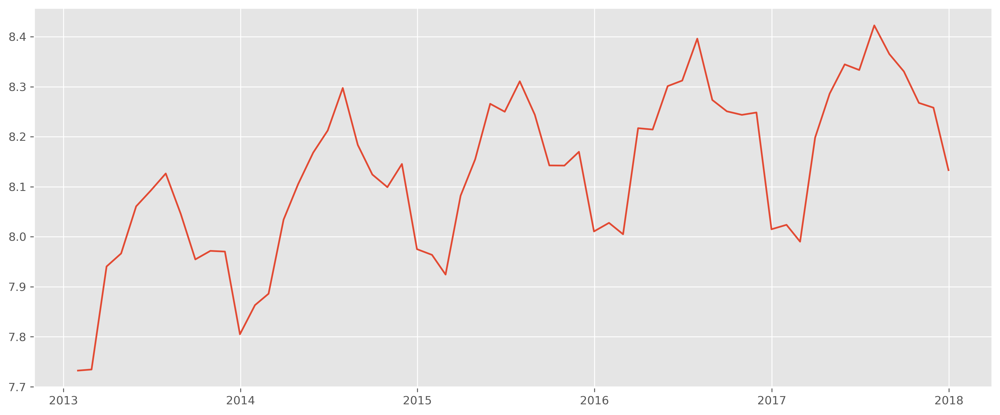

In [425]:
ts_log = np.log(y[['sales']])
plt.figure(figsize=(15,6))
plt.plot(ts_log)
plt.show()

Viendo Tendencia

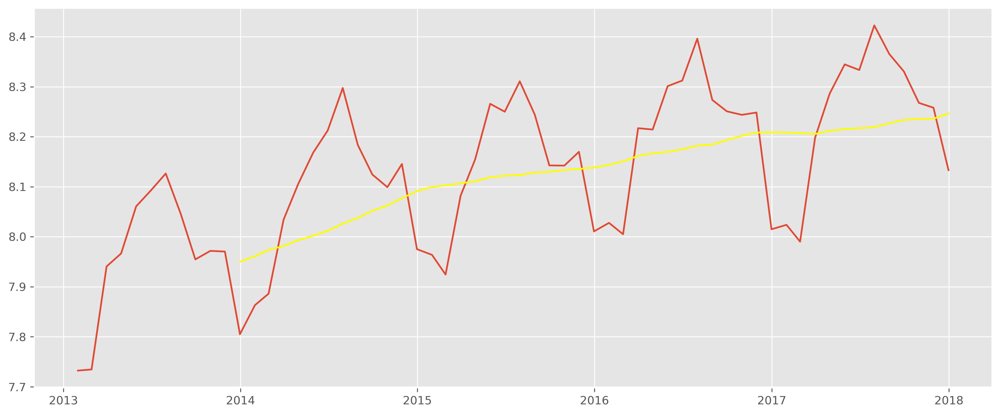

In [426]:
moving_avg = ts_log.rolling(12).mean()
plt.figure(figsize=(15,6))
plt.plot(ts_log)
plt.plot(moving_avg, color='yellow')
plt.show()

diferenciación

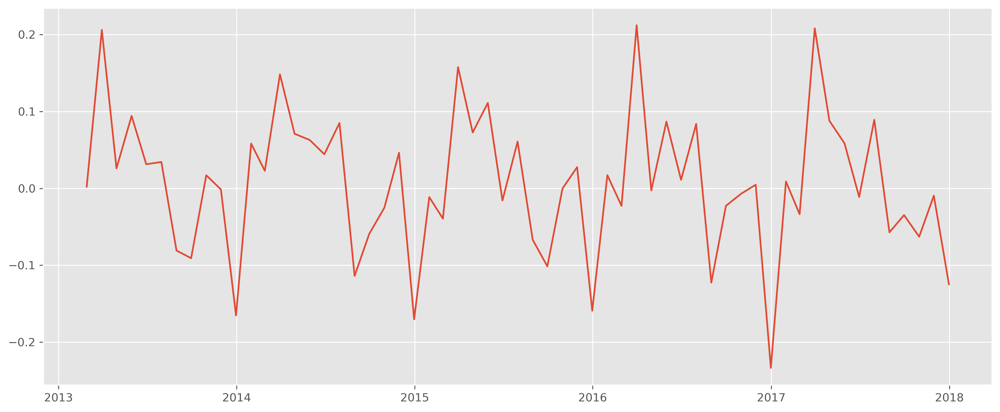

In [427]:
ts_log_diff = ts_log[['sales']] - ts_log[['sales']].shift()
plt.figure(figsize=(15,6))
plt.plot(ts_log_diff)
plt.show()

In [428]:
ts_log_diff = ts_log_diff.dropna()

ahora la serie si parece tener un comportamiento estacionario en media y varianza

ARMA

<AxesSubplot:xlabel='date'>

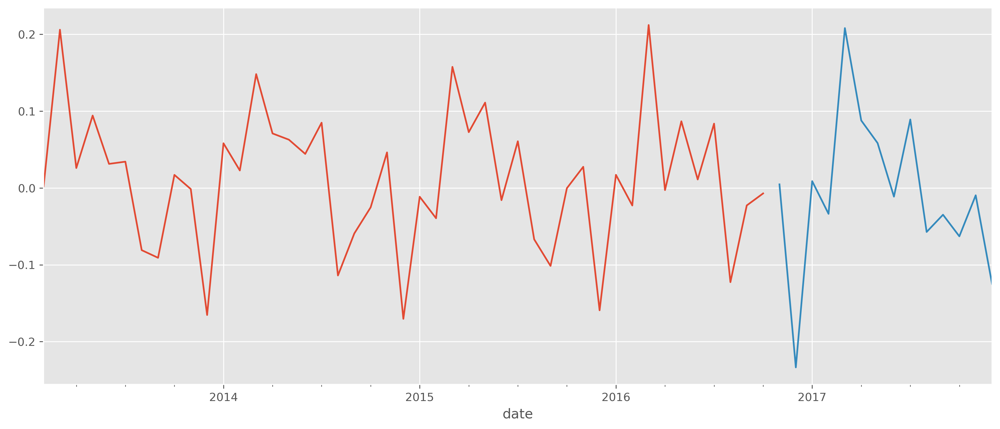

In [429]:
train = ts_log_diff[['sales']][:int(0.75*(len(y)))]
valid = ts_log_diff[['sales']][int(0.75*(len(y))):]

#plotting the data
plt.figure(figsize=(15,6))
train['sales'].plot()
valid['sales'].plot()

In [430]:
model = pm.auto_arima(train, trace=True, error_action='ignore', suppress_warnings=True)
model.fit(train)

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=-93.408, Time=0.10 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=-87.071, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=-85.131, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=-85.113, Time=0.03 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-88.326, Time=0.01 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-95.404, Time=0.09 sec
 ARIMA(0,0,2)(0,0,0)[0] intercept   : AIC=-85.103, Time=0.05 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.07 sec
 ARIMA(1,0,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.10 sec
 ARIMA(0,0,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.12 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.07 sec
 ARIMA(2,0,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.10 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=inf, Time=0.06 sec

Best model:  ARIMA(1,0,2)(0,0,0)[0] intercept
Total fit time: 0.847 seconds


ARIMA(order=(1, 0, 2), scoring_args={}, suppress_warnings=True)

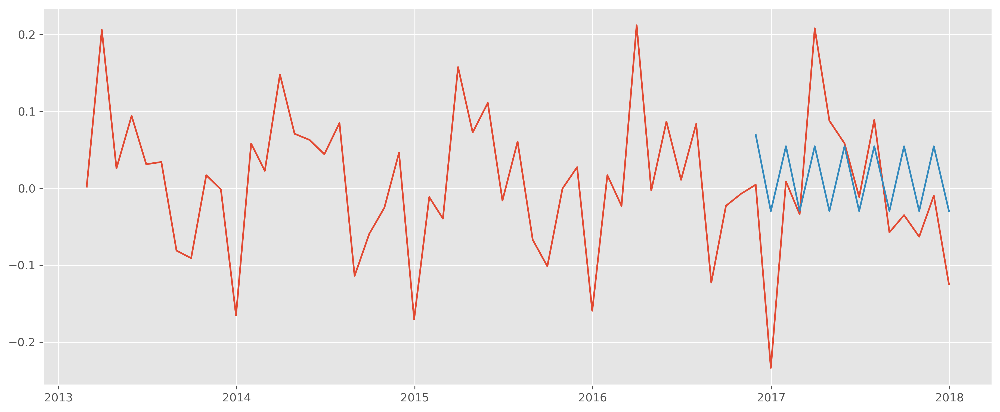

In [431]:
forecast = model.predict(n_periods=len(valid))
forecast = pd.DataFrame(forecast,index = valid.index,columns=['Prediction'])

plt.figure(figsize=(15,6))
#plot the predictions for validation set
plt.plot(ts_log_diff.sales, label='Train')
#plt.plot(valid, label='Valid')
plt.plot(forecast, label='Prediction')
# plt.xlim([datetime.date(2016, 10, 1), datetime.date(2018, 1, 1)])
plt.show()

incorporando estacionalidad

In [432]:
model = pm.auto_arima(train, trace=True, error_action='ignore', suppress_warnings=True, seasonal=True, m=12, stepwise=True)
model.fit(train)

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(1,1,1)[12] intercept   : AIC=-119.626, Time=0.41 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-112.263, Time=0.02 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-122.745, Time=0.10 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=0.16 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-114.247, Time=0.01 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=-114.607, Time=0.07 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=-124.800, Time=0.39 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-122.796, Time=0.44 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=0.27 sec
 ARIMA(0,0,0)(2,1,0)[12] intercept   : AIC=-121.378, Time=0.20 sec
 ARIMA(2,0,0)(2,1,0)[12] intercept   : AIC=-123.199, Time=0.51 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   : AIC=-123.768, Time=0.48 sec
 ARIMA(0,0,1)(2,1,0)[12] intercept   : AIC=-125.689, Time=0.42 sec
 ARIMA(0,0,1)(1,1,0)[12] intercept   : AIC=-125.146, Time=0.10 sec
 ARIMA(0,0,1)(2,1,1)[12] inte

ARIMA(order=(0, 0, 1), scoring_args={}, seasonal_order=(2, 1, 0, 12),
      suppress_warnings=True, with_intercept=False)

In [433]:
start_index = valid.index.min()
end_index = valid.index.max()

#Predictions
pred = model.predict()

In [434]:
pred = model.predict(n_periods=len(valid))
pred = pd.DataFrame(pred,index = valid.index,columns=['Prediction'])

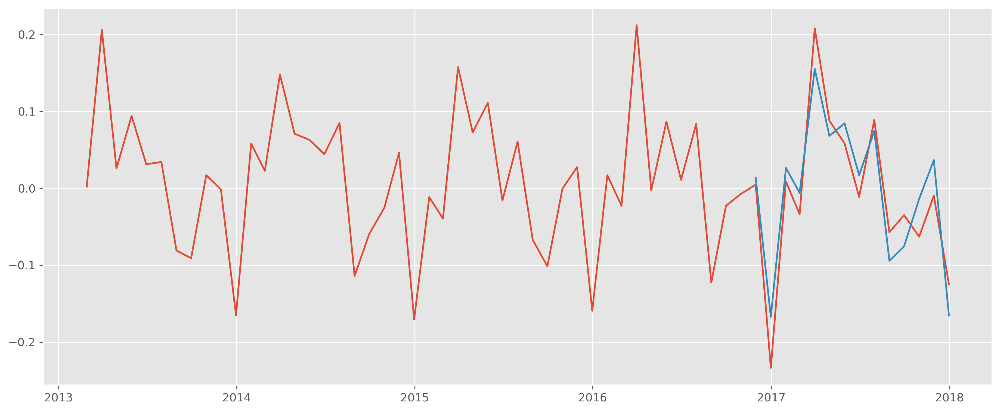

In [435]:
forecast = model.predict(n_periods=len(valid))
forecast = pd.DataFrame(forecast,index = valid.index,columns=['Prediction'])

plt.figure(figsize=(15,6))
#plot the predictions for validation set
plt.plot(ts_log_diff.sales, label='Train')
#plt.plot(valid, label='Valid')
plt.plot(forecast, label='Prediction')
# plt.xlim([datetime.date(2017, 10, 1), datetime.date(2018, 1, 1)])
plt.show()

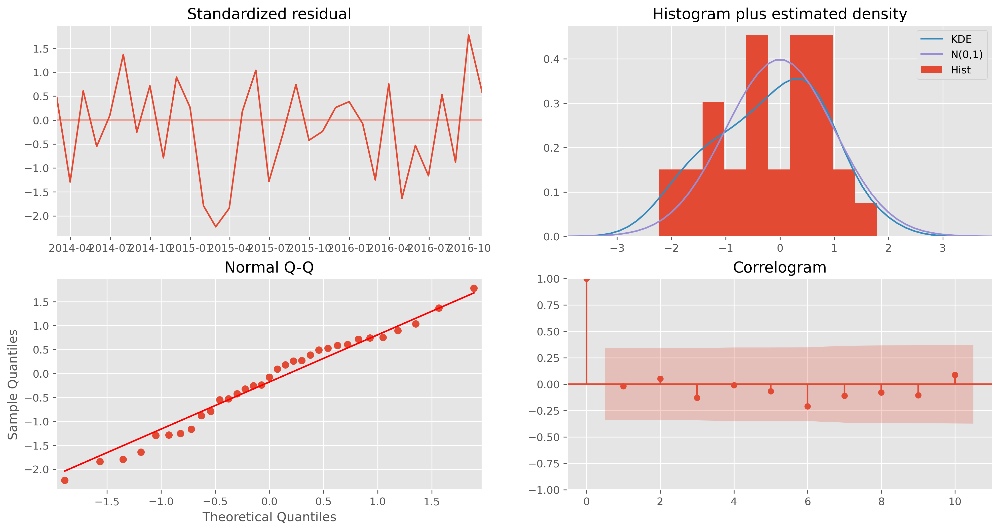

In [436]:
model.plot_diagnostics(figsize=(16, 8))
plt.show()

El modelo se comporta bien en térmninos de normalidad de residuos. Asimismo, tiene un buen performance visual.

**usando toda la serie original**

In [437]:
tss = TimeSeriesSplit(n_splits = 4)

In [438]:
X = tienda2_i28_Mensual.drop(columns=tienda2_i28_Mensual.columns)
y = tienda2_i28_Mensual[['sales']]

In [439]:
for train_index, test_index in tss.split(X):
    X_train, X_test = X.iloc[train_index, :], X.iloc[test_index,:]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

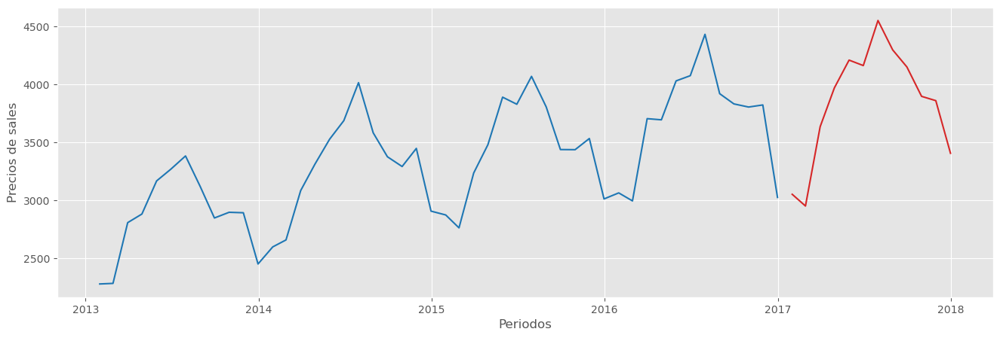

In [440]:
plt.figure(figsize=(16,5), dpi=100)
plt.plot(pd.DataFrame(y_train).index, pd.DataFrame(y_train).sales,color='tab:blue')
plt.plot(pd.DataFrame(y_test).index, pd.DataFrame(y_test).sales,color='tab:red')
plt.xlabel('Periodos')
plt.ylabel('Precios de sales')
plt.show()

In [441]:
model_auto = pm.auto_arima(y_train,
                           seasonal=True,
                           m = 12,
                           D=1,
                           stepwise=True,
                           trace=True, error_action='ignore')

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(1,1,1)[12] intercept   : AIC=inf, Time=0.39 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=469.323, Time=0.01 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=459.242, Time=0.12 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=inf, Time=0.14 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=519.614, Time=0.01 sec
 ARIMA(1,0,0)(0,1,0)[12] intercept   : AIC=459.716, Time=0.03 sec
 ARIMA(1,0,0)(2,1,0)[12] intercept   : AIC=459.878, Time=0.32 sec
 ARIMA(1,0,0)(1,1,1)[12] intercept   : AIC=inf, Time=0.23 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=457.883, Time=0.14 sec
 ARIMA(1,0,0)(0,1,2)[12] intercept   : AIC=inf, Time=0.26 sec
 ARIMA(1,0,0)(1,1,2)[12] intercept   : AIC=inf, Time=0.39 sec
 ARIMA(0,0,0)(0,1,1)[12] intercept   : AIC=inf, Time=0.08 sec
 ARIMA(2,0,0)(0,1,1)[12] intercept   : AIC=458.728, Time=0.16 sec
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=457.935, Time=0.22 sec
 ARIMA(2,0,1)(0,1,1)[12] intercept   : AIC=459.924, Time=

In [442]:
results = model_auto.fit(y_train)

In [443]:
print(results.summary())

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                   48
Model:             SARIMAX(1, 0, 0)x(0, 1, [1], 12)   Log Likelihood                -224.942
Date:                              Sun, 02 Jul 2023   AIC                            457.883
Time:                                      20:44:00   BIC                            464.217
Sample:                                  01-31-2013   HQIC                           460.094
                                       - 12-31-2016                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept    145.6247     58.884      2.473      0.013      30.214     261.035
ar.L1          0.47

In [444]:
model_auto.aic()

457.8834108293513

In [445]:
forecast_autoarima = model_auto.predict(n_periods=12)
forecast_autoarima

2017-01-31   3241.073
2017-02-28   3267.843
2017-03-31   3873.046
2017-04-30   3999.476
2017-05-31   4333.369
2017-06-30   4381.963
2017-07-31   4670.648
2017-08-31   4274.334
2017-09-30   4067.912
2017-10-31   4048.979
2017-11-30   4109.786
2017-12-31   3482.441
Freq: M, dtype: float64

In [446]:
forecast_autoarima = pd.DataFrame(forecast_autoarima)
forecast_autoarima.index = y_test.index
forecast_autoarima.columns = ['forecast']

<Figure size 500x500 with 0 Axes>

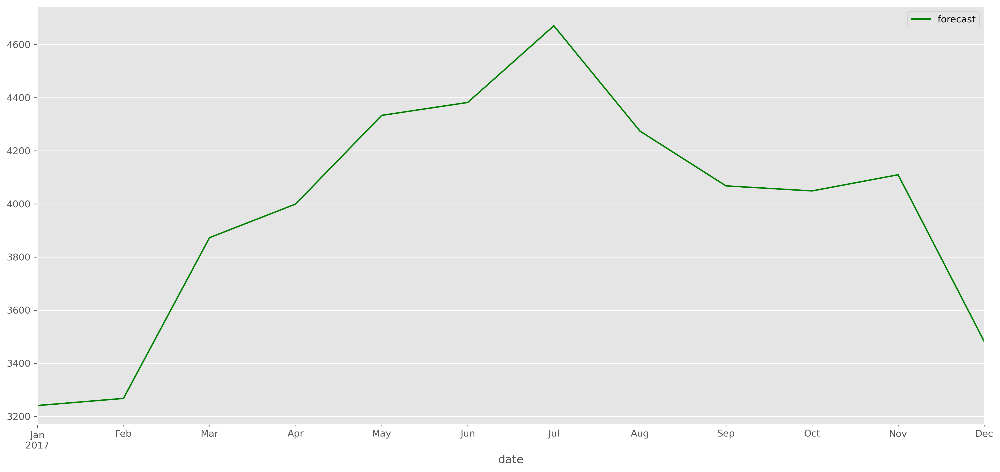

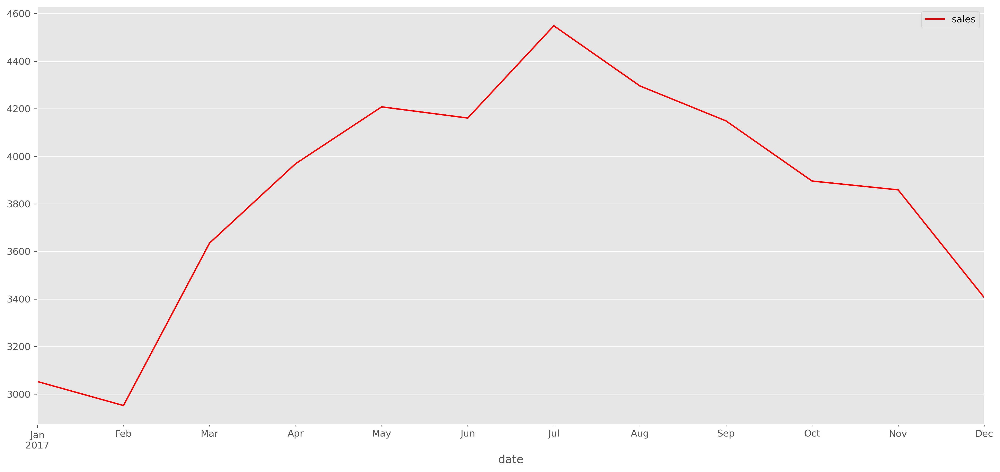

In [447]:
# plot
plt.figure(figsize=(5,5), dpi=100)
forecast_autoarima.plot(color = 'green', legend = True)
y_test.plot(color='red',legend = True)
plt.show()

Prediciendo el siguiente Mes con Autoarima

In [448]:
y_train = tienda2_i28_Mensual[['sales']]

In [449]:
model_auto = pm.auto_arima(y_train,
                           seasonal=True,
                           m = 12,
                           D=1,
                           stepwise=True,
                           trace=True, error_action='ignore')

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,1,1)[12]             : AIC=597.755, Time=0.53 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=610.808, Time=0.01 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=596.046, Time=0.07 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=595.367, Time=0.09 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=605.437, Time=0.03 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=594.658, Time=0.15 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=592.831, Time=0.07 sec
 ARIMA(0,1,1)(2,1,0)[12]             : AIC=594.615, Time=0.16 sec
 ARIMA(0,1,1)(2,1,1)[12]             : AIC=inf, Time=0.39 sec
 ARIMA(0,1,0)(1,1,0)[12]             : AIC=596.775, Time=0.05 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=592.046, Time=0.21 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=605.028, Time=0.04 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=593.529, Time=0.25 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=593.614, Time=0.25 sec
 ARIMA(1,1,1)(0,1,1)[12]             

In [450]:
results = model_auto.fit(y_train)

In [451]:
print(results.summary())

                                      SARIMAX Results                                      
Dep. Variable:                                   y   No. Observations:                   60
Model:             SARIMAX(1, 1, 1)x(1, 1, [], 12)   Log Likelihood                -292.023
Date:                             Sun, 02 Jul 2023   AIC                            592.046
Time:                                     20:44:12   BIC                            599.446
Sample:                                 01-31-2013   HQIC                           594.830
                                      - 12-31-2017                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4105      0.197      2.083      0.037       0.024       0.797
ma.L1         -0.8300      

In [452]:
model_auto.aic()

592.0455755814813

In [453]:
forecast_autoarima = model_auto.predict(n_periods=1)
forecast_autoarima

2018-01-31   3420.993
Freq: M, dtype: float64

In [454]:
Ventas_M_SARIMAX = forecast_autoarima[0].round(2)
Ventas_M_SARIMAX

3420.99

La predicción del siguiente mes, a comparación de las técnincas de suavizamiento exponencial, es menor.

## Conclusiones

In [456]:
Ventas_D_Prophet, Ventas_M_Prophet

(3266.96, 3315.1)

In [457]:
Ventas_D_HW, Ventas_M_HW

(2905.23, 3548.24)

In [458]:
Ventas_D_SARIMAX, Ventas_M_SARIMAX

(3532.33, 3420.99)

Tanto para las ventas diarias y mensuales el moodelo prophet tuvo un buen desempeño, asimismo, las ventas no tienen tanto margen de diferencia.

Para HW, la diferencia entre las distintas frecuencias es mayor, considerando que, para la frecuencia diaria se utlizaron los últimos 6 meses; mientras que, para la mensual, solo el último año.

En el caso de ARIMA, si bien la suma total mensual no es tan diferente, se puede ver que para la frecuencia diaria no se logra captar la volatilidad diaria propia de cada día; mientras que, para el mensual, si se nota un mejor ajuste.

Las ventajas de trabajar con frecuencia diaria es que, en parte de la predicción, se pueda ver qué semanas o días específicos del més pueda haber una demanda más elevada o menor. Por otra parte, la data mensual consta de menos registros (menor carga de tiempo), y los modelos no tienen tanto problema al captar las volatilidades (como el caso de ARIMA en ventas diarias).

Por esto, será preferible trabajar con frecuencia diaria

## Forecasting con Pycaret (Extra)

### Diario

In [544]:
train, test= np.split(tienda2_i28.drop(columns=['item','date', 'quarter', 'month', 'year', 'dayofyear', 'dayofmonth','weekofyear', 'dayofweek', 'is_weekday']), [int(.90 * len(tienda2_i28.drop(columns=['date', 'quarter', 'month', 'year', 'dayofyear', 'dayofmonth','weekofyear', 'dayofweek', 'is_weekday'])))])
train.shape, test.shape

((1643, 1), (183, 1))

In [545]:
exp = TSForecastingExperiment()

In [546]:
exp.setup(data=tienda2_i28.drop(columns=['item','date', 'quarter', 'month', 'year', 'dayofyear', 'dayofmonth','weekofyear', 'dayofweek', 'is_weekday']),session_id=42,fh=12)

,Description,Value
0,session_id,42
1,Target,sales
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(1826, 1)"
5,Transformed data shape,"(1826, 1)"
6,Transformed train set shape,"(1814, 1)"
7,Transformed test set shape,"(12, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


In [547]:
exp.compare_models(sort='RMSE')

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
catboost_cds_dt,CatBoost Regressor w/ Cond. Deseasonalize & Detrending,0.8438,0.7910,19.2248,23.2667,0.1813,0.1637,0.1909,1.3733
lightgbm_cds_dt,Light Gradient Boosting w/ Cond. Deseasonalize & Detrending,0.8900,0.8382,20.2757,24.6546,0.1938,0.1709,0.0997,0.3000
ada_cds_dt,AdaBoost w/ Cond. Deseasonalize & Detrending,0.9086,0.8530,20.7026,25.0901,0.1974,0.1744,0.0448,0.2367
et_cds_dt,Extra Trees w/ Cond. Deseasonalize & Detrending,0.9429,0.8671,21.4840,25.5026,0.2096,0.1800,0.0551,0.2867
xgboost_cds_dt,Extreme Gradient Boosting w/ Cond. Deseasonalize & Detrending,0.9653,0.8777,21.9917,25.8157,0.2130,0.1838,0.0281,0.4400
omp_cds_dt,Orthogonal Matching Pursuit w/ Cond. Deseasonalize & Detrending,0.9595,0.8791,21.8600,25.8582,0.2096,0.1835,0.0192,0.1300
gbr_cds_dt,Gradient Boosting w/ Cond. Deseasonalize & Detrending,1.0038,0.8872,22.8698,26.0976,0.2188,0.1902,-0.0141,0.7200
br_cds_dt,Bayesian Ridge w/ Cond. Deseasonalize & Detrending,0.9463,0.8879,21.5589,26.1163,0.2026,0.1812,-0.0575,0.2967
lasso_cds_dt,Lasso w/ Cond. Deseasonalize & Detrending,0.9464,0.8889,21.5631,26.1470,0.2025,0.1812,-0.0612,0.3700
llar_cds_dt,Lasso Least Angular Regressor w/ Cond. Deseasonalize & Detrending,0.9464,0.8889,21.5631,26.1471,0.2025,0.1812,-0.0612,0.2967


Processing:   0%|          | 0/121 [00:00<?, ?it/s]

BaseCdsDtForecaster(fe_target_rr=[WindowSummarizer(lag_feature={'lag': [28, 27,
                                                                        26, 25,
                                                                        24, 23,
                                                                        22, 21,
                                                                        20, 19,
                                                                        18, 17,
                                                                        16, 15,
                                                                        14, 13,
                                                                        12, 11,
                                                                        10, 9,
                                                                        8, 7, 6,
                                                                        5, 4, 3,
                                                                        2, 1]},
                                                   n_jobs=1)],
                    regressor=<catboost.core.CatBoostRegressor object at 0x0000020888C60400>,
                    sp=28, window_length=28)

In [548]:
model = exp.create_model("catboost_cds_dt")
model

,cutoff,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,2017-11-13,0.5425,0.5386,12.3643,15.8580,0.0897,0.0945,0.2240
1,2017-11-25,0.6483,0.6261,14.7506,18.3964,0.1244,0.1150,0.4040
2,2017-12-07,1.3406,1.2083,30.5596,35.5457,0.3296,0.2816,-0.0555
Mean,NaT,0.8438,0.7910,19.2248,23.2667,0.1813,0.1637,0.1909
SD,NaT,0.3540,0.2972,8.0739,8.7442,0.1059,0.0838,0.1891


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

BaseCdsDtForecaster(fe_target_rr=[WindowSummarizer(lag_feature={'lag': [28, 27,
                                                                        26, 25,
                                                                        24, 23,
                                                                        22, 21,
                                                                        20, 19,
                                                                        18, 17,
                                                                        16, 15,
                                                                        14, 13,
                                                                        12, 11,
                                                                        10, 9,
                                                                        8, 7, 6,
                                                                        5, 4, 3,
                                                                        2, 1]},
                                                   n_jobs=1)],
                    regressor=<catboost.core.CatBoostRegressor object at 0x0000020888CC7D30>,
                    sp=28, window_length=28)

In [549]:
exp.plot_model(model, plot = 'forecast')

### Mensual

In [502]:
train, test= np.split(tienda2_i28_Mensual.drop(columns=['date', 'quarter', 'month', 'year', 'dayofyear', 'dayofmonth','weekofyear', 'dayofweek', 'is_weekday']), [int(.90 * len(tienda2_i28_Mensual.drop(columns=['date', 'quarter', 'month', 'year', 'dayofyear', 'dayofmonth','weekofyear', 'dayofweek', 'is_weekday'])))])
train.shape, test.shape

((54, 1), (6, 1))

In [514]:
exp = TSForecastingExperiment()

In [515]:
exp.setup(data=tienda2_i28_Mensual.drop(columns=['date', 'quarter', 'month', 'year', 'dayofyear', 'dayofmonth','weekofyear', 'dayofweek', 'is_weekday']),session_id=42,fh=12)

,Description,Value
0,session_id,42
1,Target,sales
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(60, 1)"
5,Transformed data shape,"(60, 1)"
6,Transformed train set shape,"(48, 1)"
7,Transformed test set shape,"(12, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


In [516]:
exp.compare_models(sort='RMSE')

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
stlf,STLF,nan,nan,278.3452,297.2704,0.0828,0.0849,0.3658,0.0367
snaive,Seasonal Naive Forecaster,nan,nan,280.5833,301.4623,0.0815,0.0861,0.3786,0.4300
xgboost_cds_dt,Extreme Gradient Boosting w/ Cond. Deseasonalize & Detrending,nan,nan,263.4821,305.6347,0.0783,0.0767,0.4077,0.1233
polytrend,Polynomial Trend Forecaster,nan,nan,341.4540,430.8069,0.1041,0.0993,-0.1207,0.4200
croston,Croston,nan,nan,511.6051,579.8808,0.1418,0.1538,-1.0825,0.0133
grand_means,Grand Means Forecaster,nan,nan,520.9259,598.1385,0.1423,0.1550,-1.1368,0.4167
naive,Naive Forecaster,nan,nan,698.6389,802.7269,0.1909,0.2179,-2.9276,0.6200


Processing:   0%|          | 0/121 [00:00<?, ?it/s]

STLForecaster(sp=12)

In [517]:
model = exp.create_model("stlf")
model

,cutoff,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,2013-12,nan,nan,433.1667,443.8440,0.1314,0.1409,-0.2332
1,2014-12,0.6393,0.6541,276.9167,290.3131,0.0817,0.0781,0.4647
2,2015-12,0.4240,0.4659,124.9522,157.6542,0.0353,0.0356,0.8660
Mean,NaT,nan,nan,278.3452,297.2704,0.0828,0.0849,0.3658
SD,NaT,nan,nan,125.8321,116.9400,0.0392,0.0432,0.4541


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

STLForecaster(sp=12)

In [529]:
exp.plot_model(model, plot = 'forecast')

In [530]:
model2 = exp.create_model("xgboost_cds_dt")
model2

,cutoff,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,2013-12,nan,nan,317.4545,388.4574,0.0965,0.0977,0.0554
1,2014-12,0.6174,0.6346,267.4165,281.6478,0.0788,0.0754,0.4962
2,2015-12,0.6976,0.7293,205.5753,246.7991,0.0598,0.0571,0.6715
Mean,NaT,nan,nan,263.4821,305.6347,0.0783,0.0767,0.4077
SD,NaT,nan,nan,45.7592,60.2677,0.0150,0.0166,0.2592


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

BaseCdsDtForecaster(fe_target_rr=[WindowSummarizer(lag_feature={'lag': [12, 11,
                                                                        10, 9,
                                                                        8, 7, 6,
                                                                        5, 4, 3,
                                                                        2, 1]},
                                                   n_jobs=1)],
                    regressor=XGBRegressor(base_score=None, booster='gbtree', callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gp...e, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=-1, num_parallel_tree=None,
             predictor=None, random_state=42, ...),
                    sp=12, window_length=12)

In [531]:
exp.plot_model(model2, plot = 'forecast')